<a href="https://colab.research.google.com/github/ElaiEmylleMatos/HAR-smartphones/blob/main/cuhk_face_sketch_database_cufs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Preparação dos dados

### Importando as bibliotecas necessárias:

In [3]:
import tensorflow as tf                  # Biblioteca principal para aprendizado de máquina, especialmente redes neurais.
from tensorflow import keras             # Simplifica a criação e treinamento de modelos.
from tensorflow.keras import layers      # Permite criar as diferentes camadas de uma rede neural (densas, convolucionais, etc.).
import matplotlib.pyplot as plt          # Criar gráficos e visualizações
import numpy as np                       # Operações numéricas em Python


### Carregando e exibindo o dataset

In [24]:
import os

!pip install kaggle
!kaggle datasets download -d arbazkhan971/cuhk-face-sketch-database-cufs --force
!unzip -oq "cuhk-face-sketch-database-cufs.zip"

def list_files_in_folder(folder_path):
  """Lista todos os arquivos de uma determinada pasta."""
  try:
    file_list = os.listdir(folder_path)
    return file_list
  except FileNotFoundError:
    print(f"Erro: Pasta não encontrada em {folder_path}")
    return []

# Caminho da pasta onde as imagens estão armazenadas
photos_folder = "photos"
files_in_photos = list_files_in_folder(photos_folder)

Dataset URL: https://www.kaggle.com/datasets/arbazkhan971/cuhk-face-sketch-database-cufs
License(s): copyright-authors
 80% 91.0M/113M [00:00<00:00, 83.2MB/s]
100% 113M/113M [00:01<00:00, 110MB/s]  


In [5]:
print(files_in_photos)
print("Total de imagens:", len(files_in_photos))

['m1-011-01.jpg', 'm-039-01.jpg', 'm-065-01.jpg', 'm1-037-01.jpg', 'm-044-01.jpg', 'f1-004-01.jpg', 'm1-039-01.jpg', 'm-038-01.jpg', 'm-099-01.jpg', 'm1-005-01.jpg', 'm-016-01.jpg', 'm1-007-01.jpg', 'm-073-01.jpg', 'f-043-01.jpg', 'f-010-01.jpg', 'm-015-01.jpg', 'm-085-01.jpg', 'm-034-01.jpg', 'm1-028-01.jpg', 'm-049-01.jpg', 'm-091-01.jpg', 'm1-036-01.jpg', 'm-018-01.jpg', 'm-077-01.jpg', 'f-033-01.jpg', 'm-097-01.jpg', 'm-095-01.jpg', 'm-031-01.jpg', 'f-027-01.jpg', 'm-027-01.jpg', 'm-025-01.jpg', 'f-018-01.jpg', 'f1-011-01.jpg', 'f-024-01.jpg', 'm-089-01.jpg', 'f1-012-01.jpg', 'm-096-01.jpg', 'f-026-01.jpg', 'm1-023-01.jpg', 'm-041-01.jpg', 'f-039-01.jpg', 'm-010-01.jpg', 'f1-007-01.jpg', 'm-071-01.jpg', 'f1-001-01.jpg', 'm1-017-01.jpg', 'm-069-01.jpg', 'f-008-01.jpg', 'm-014-01.jpg', 'm-075-01.jpg', 'f1-010-01.jpg', 'm-052-01.jpg', 'm-061-01.jpg', 'm-019-01.jpg', 'f-022-01.jpg', 'm1-024-01.jpg', 'm-050-01.jpg', 'm-029-01.jpg', 'm1-038-01.jpg', 'f-005-01.jpg', 'm-037-01.jpg', 'm1-01

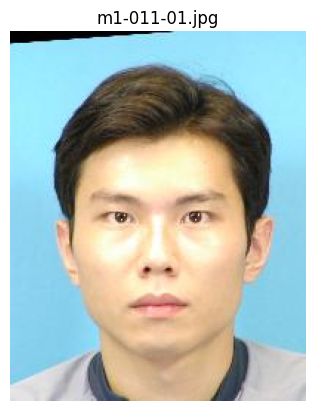

m1-011-01.jpg - (200, 250)


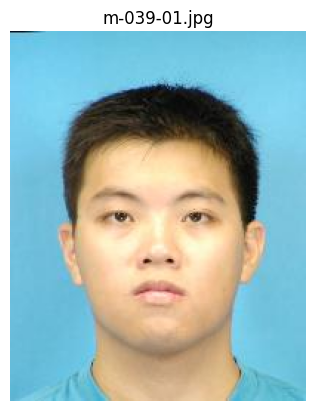

m-039-01.jpg - (200, 250)


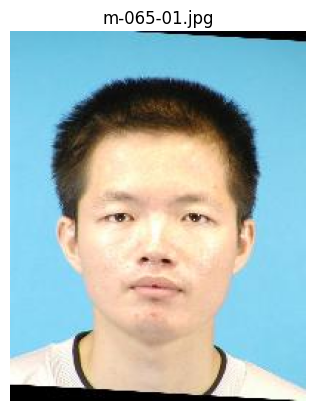

m-065-01.jpg - (200, 250)


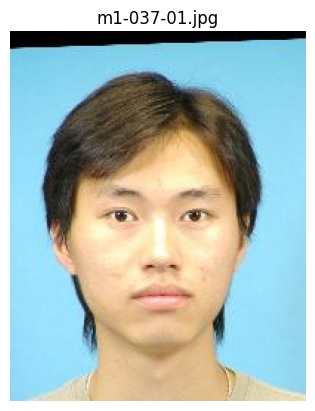

m1-037-01.jpg - (200, 250)


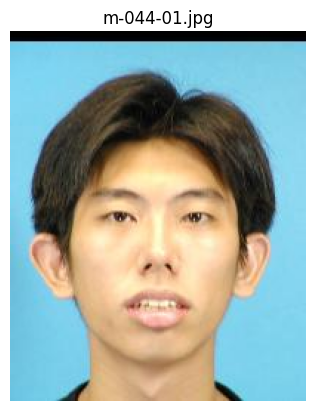

m-044-01.jpg - (200, 250)


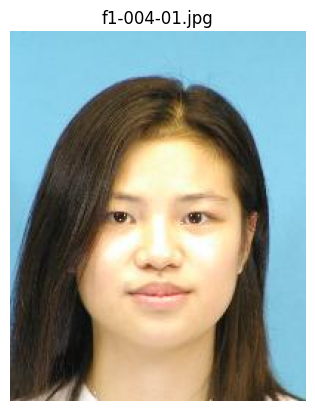

f1-004-01.jpg - (200, 250)


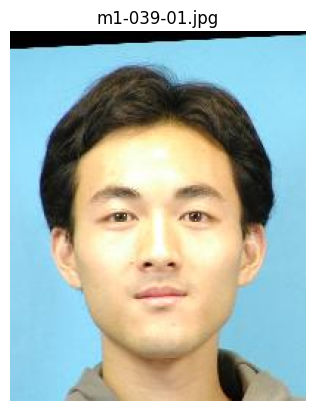

m1-039-01.jpg - (200, 250)


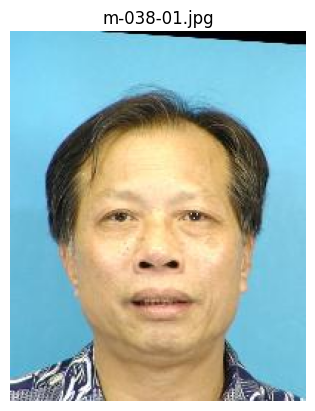

m-038-01.jpg - (200, 250)


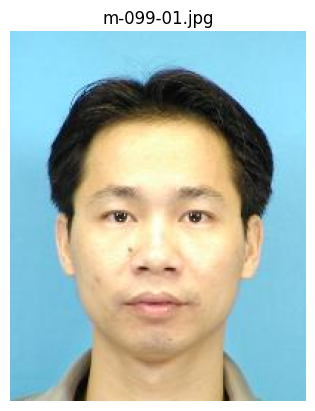

m-099-01.jpg - (200, 250)


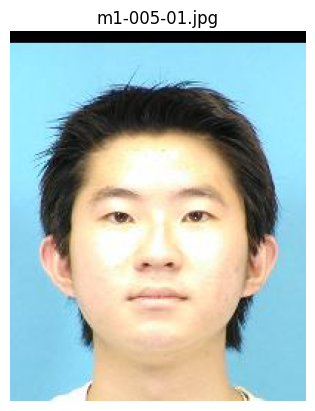

m1-005-01.jpg - (200, 250)


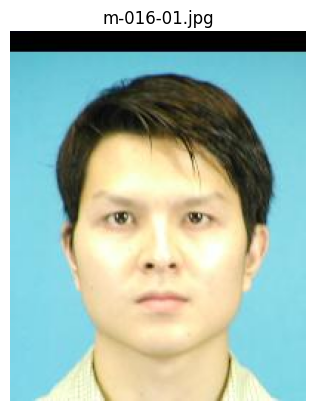

m-016-01.jpg - (200, 250)


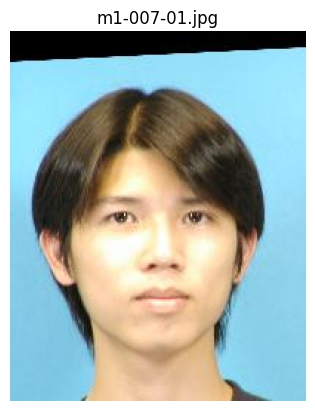

m1-007-01.jpg - (200, 250)


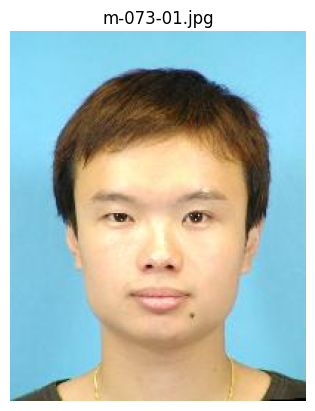

m-073-01.jpg - (200, 250)


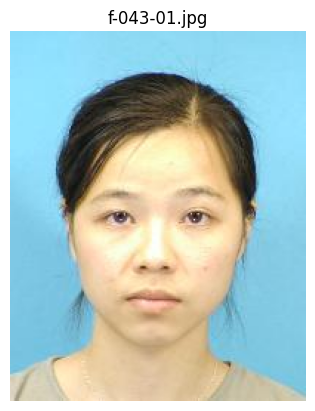

f-043-01.jpg - (200, 250)


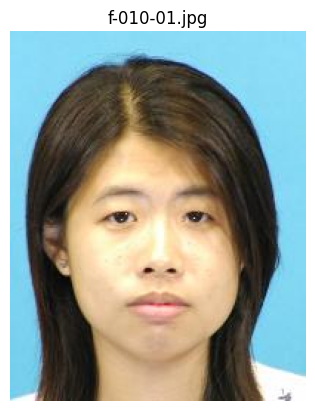

f-010-01.jpg - (200, 250)


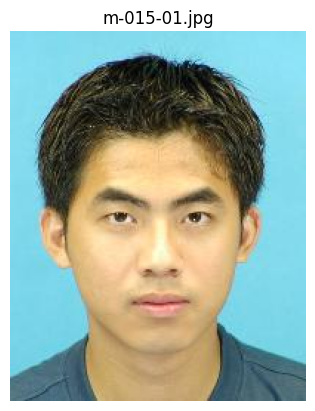

m-015-01.jpg - (200, 250)


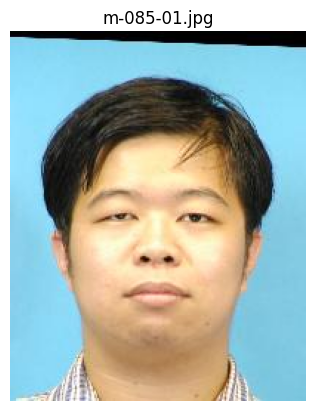

m-085-01.jpg - (200, 250)


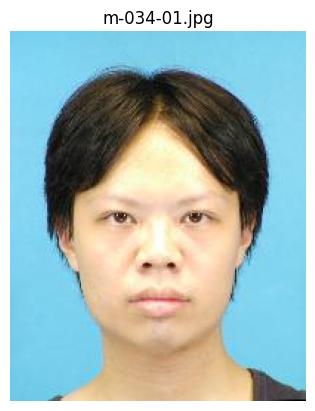

m-034-01.jpg - (200, 250)


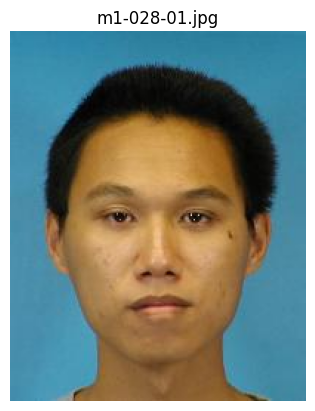

m1-028-01.jpg - (200, 250)


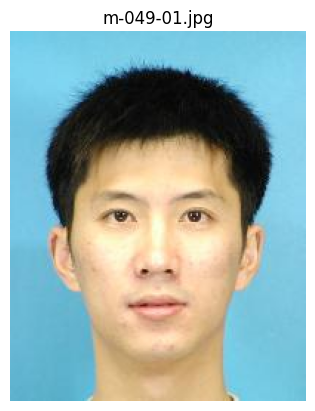

m-049-01.jpg - (200, 250)


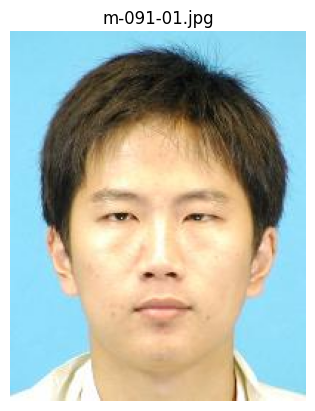

m-091-01.jpg - (200, 250)


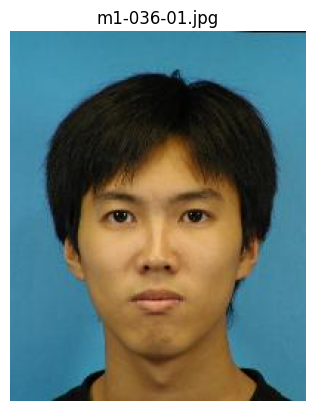

m1-036-01.jpg - (200, 250)


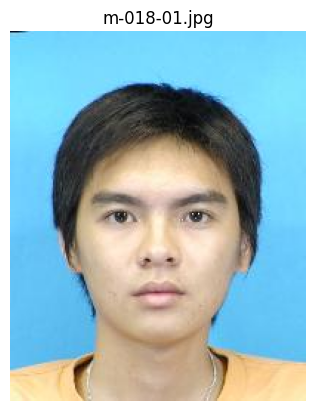

m-018-01.jpg - (200, 250)


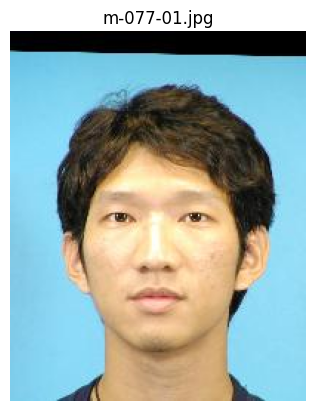

m-077-01.jpg - (200, 250)


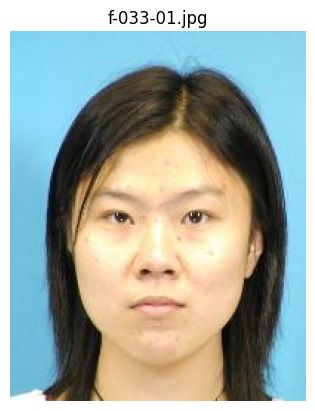

f-033-01.jpg - (200, 250)


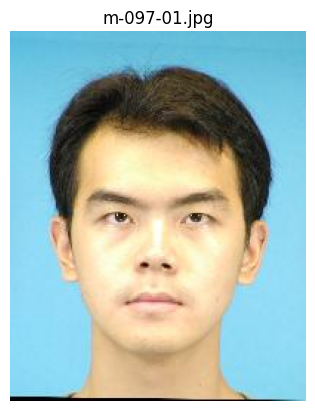

m-097-01.jpg - (200, 250)


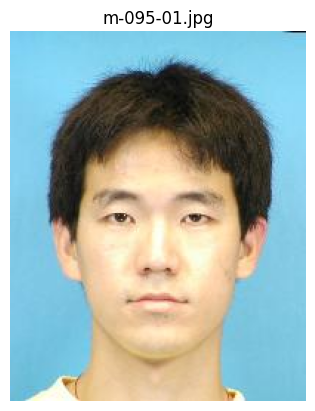

m-095-01.jpg - (200, 250)


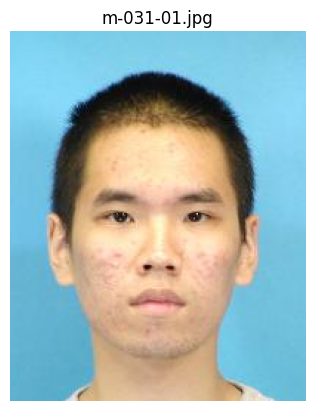

m-031-01.jpg - (200, 250)


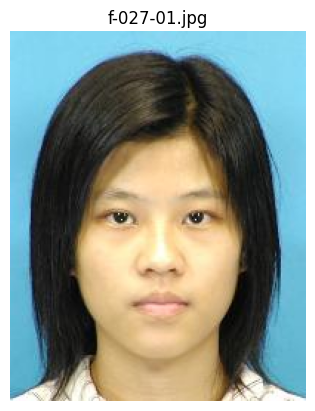

f-027-01.jpg - (200, 250)


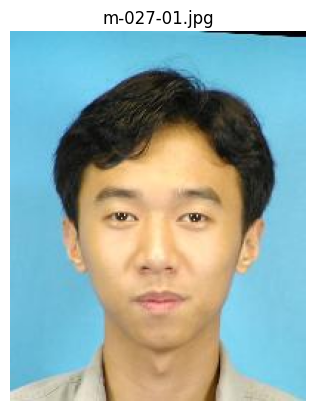

m-027-01.jpg - (200, 250)


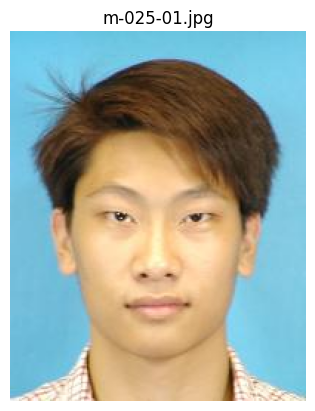

m-025-01.jpg - (200, 250)


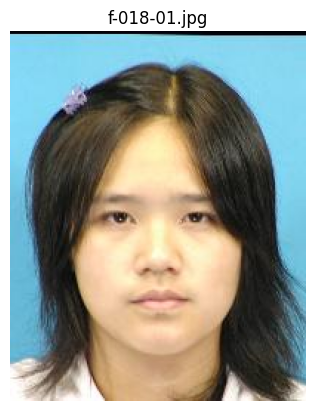

f-018-01.jpg - (200, 250)


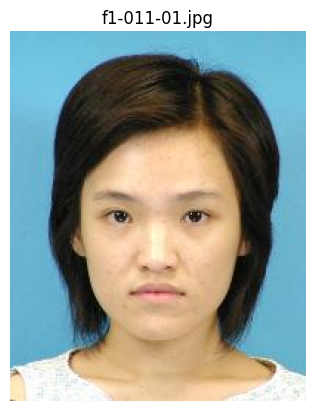

f1-011-01.jpg - (200, 250)


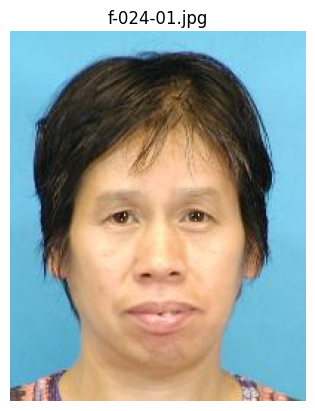

f-024-01.jpg - (200, 250)


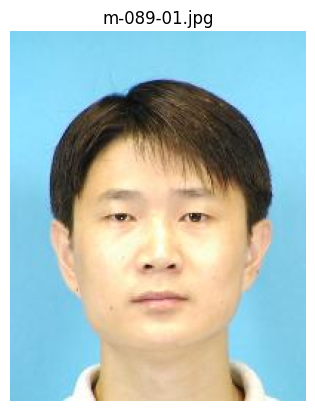

m-089-01.jpg - (200, 250)


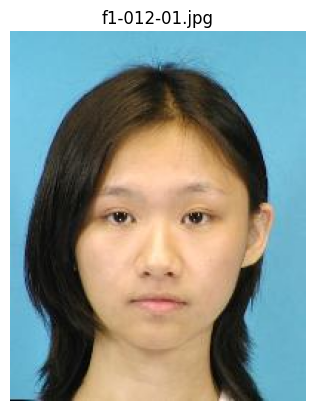

f1-012-01.jpg - (200, 250)


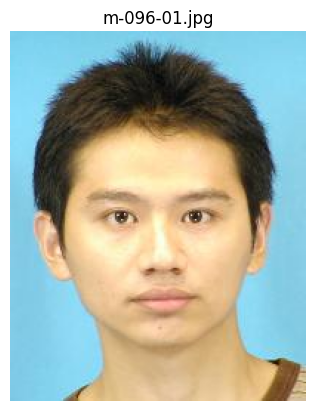

m-096-01.jpg - (200, 250)


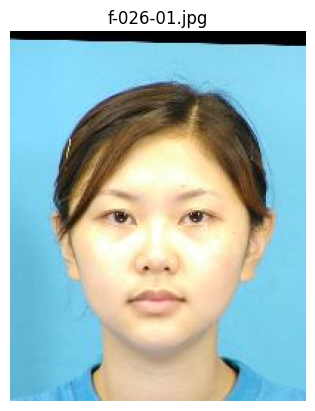

f-026-01.jpg - (200, 250)


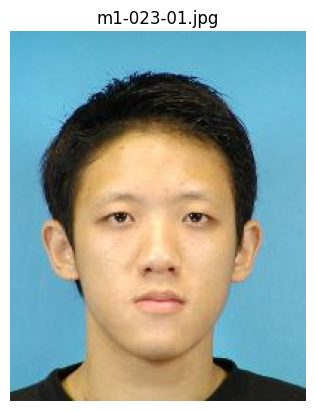

m1-023-01.jpg - (200, 250)


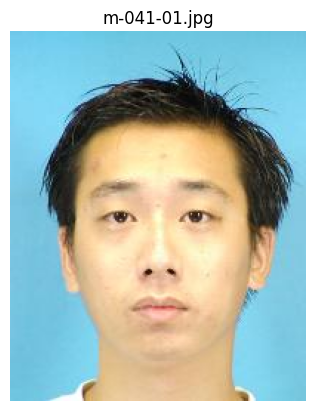

m-041-01.jpg - (200, 250)


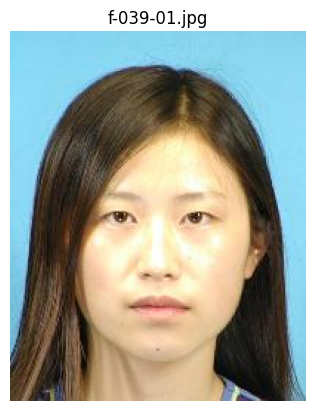

f-039-01.jpg - (200, 250)


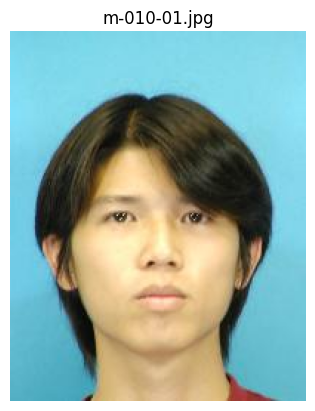

m-010-01.jpg - (200, 250)


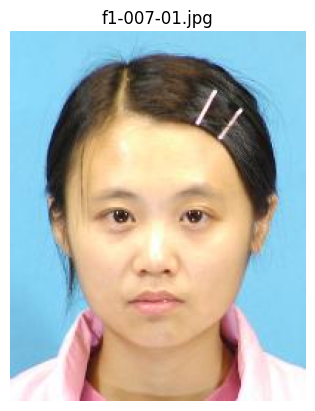

f1-007-01.jpg - (200, 250)


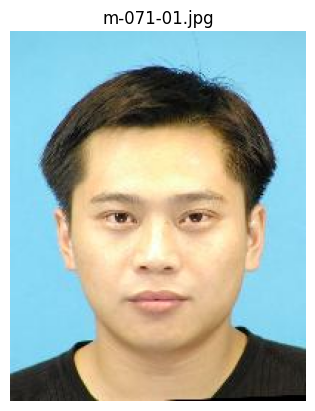

m-071-01.jpg - (200, 250)


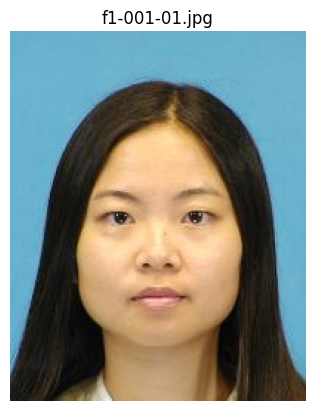

f1-001-01.jpg - (200, 250)


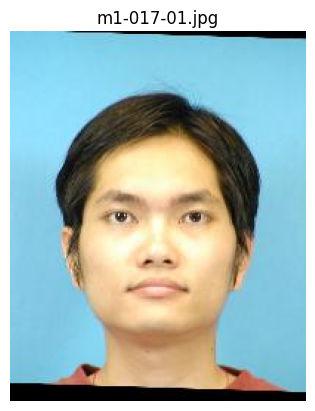

m1-017-01.jpg - (200, 250)


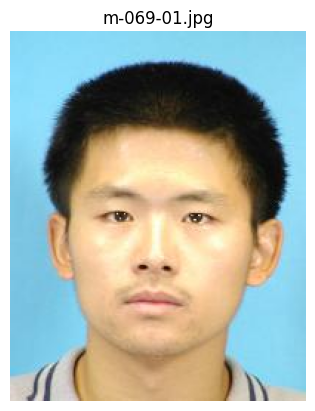

m-069-01.jpg - (200, 250)


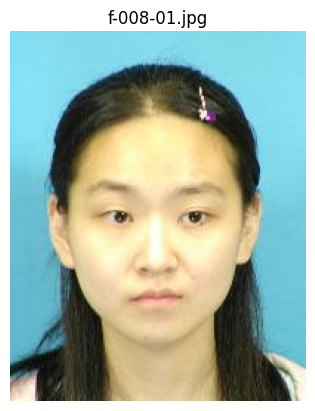

f-008-01.jpg - (200, 250)


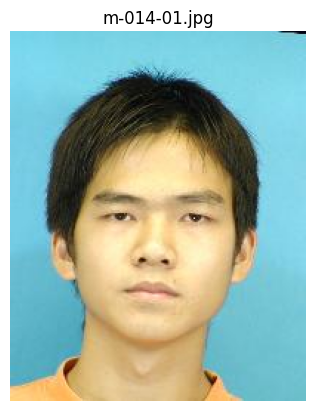

m-014-01.jpg - (200, 250)


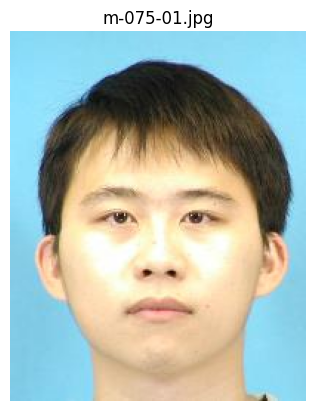

m-075-01.jpg - (200, 250)


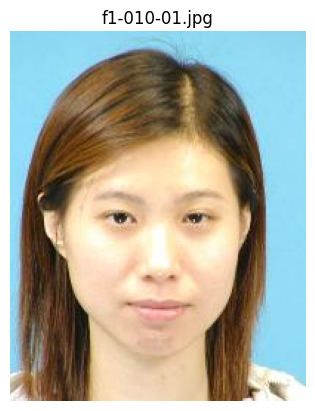

f1-010-01.jpg - (200, 250)


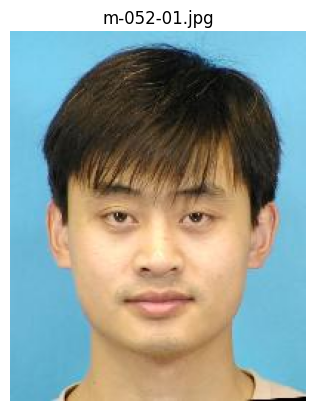

m-052-01.jpg - (200, 250)


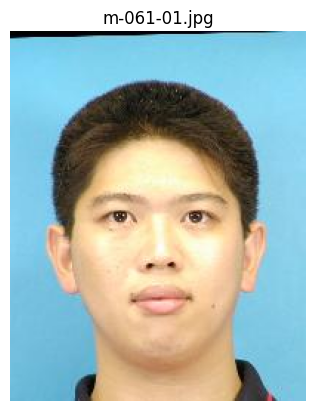

m-061-01.jpg - (200, 250)


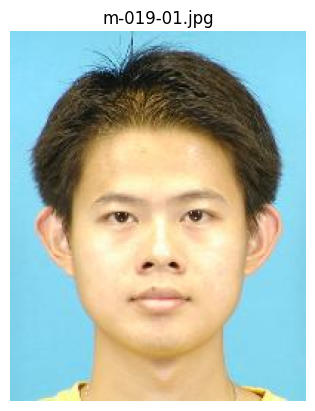

m-019-01.jpg - (200, 250)


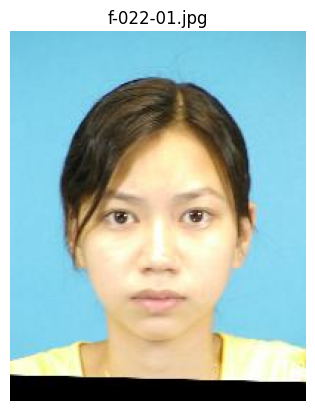

f-022-01.jpg - (200, 250)


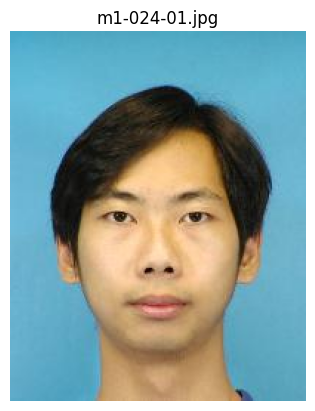

m1-024-01.jpg - (200, 250)


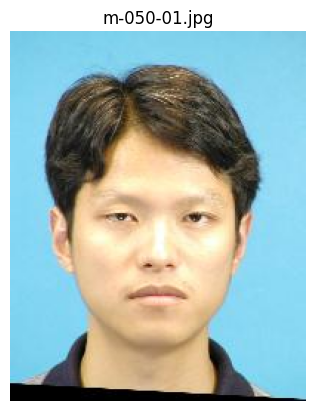

m-050-01.jpg - (200, 250)


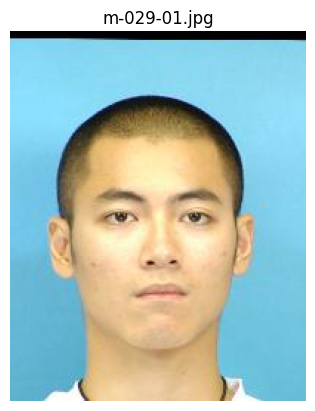

m-029-01.jpg - (200, 250)


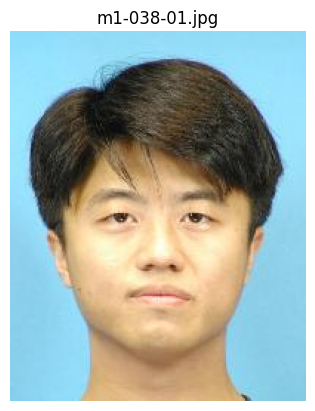

m1-038-01.jpg - (200, 250)


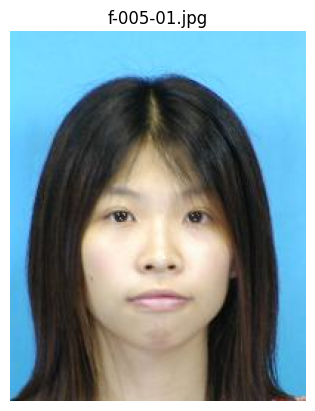

f-005-01.jpg - (200, 250)


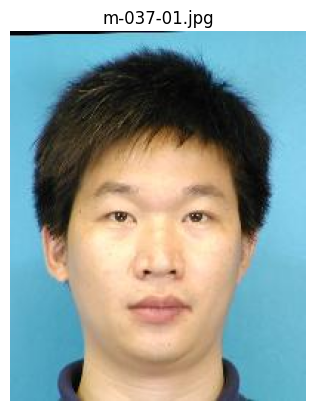

m-037-01.jpg - (200, 250)


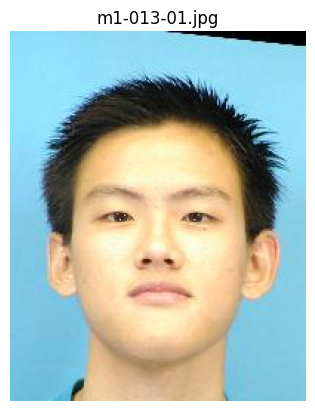

m1-013-01.jpg - (200, 250)


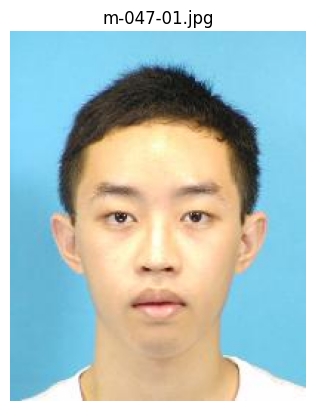

m-047-01.jpg - (200, 250)


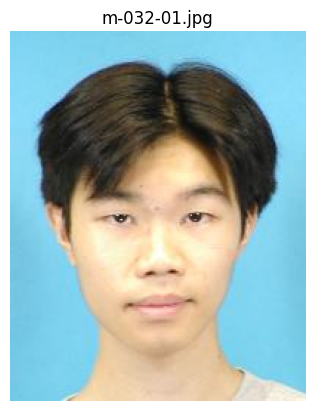

m-032-01.jpg - (200, 250)


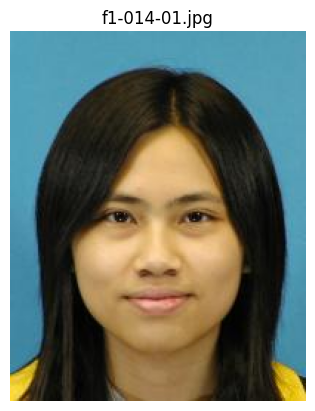

f1-014-01.jpg - (200, 250)


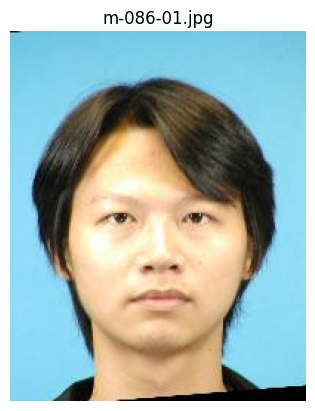

m-086-01.jpg - (200, 250)


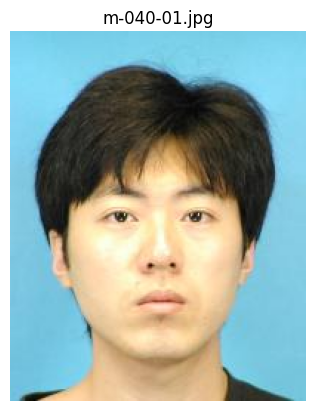

m-040-01.jpg - (200, 250)


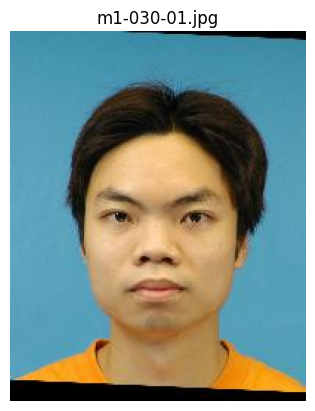

m1-030-01.jpg - (200, 250)


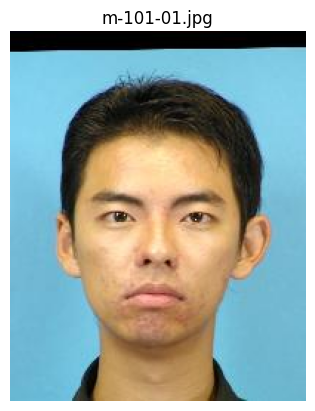

m-101-01.jpg - (200, 250)


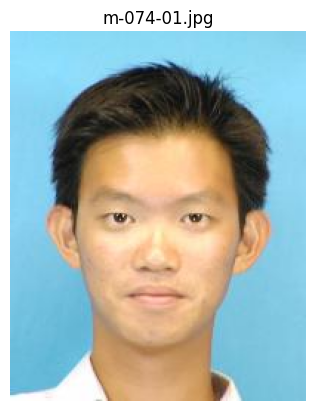

m-074-01.jpg - (200, 250)


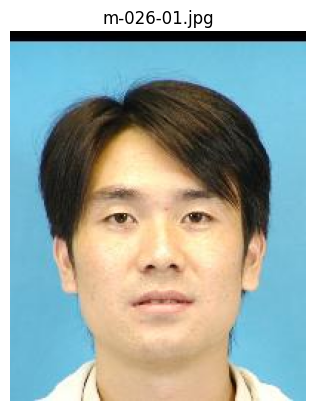

m-026-01.jpg - (200, 250)


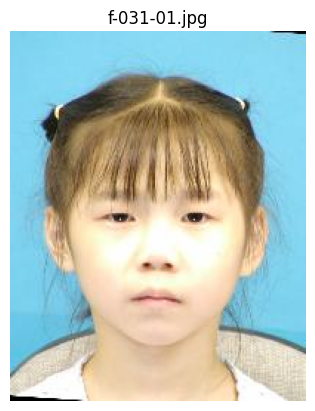

f-031-01.jpg - (200, 250)


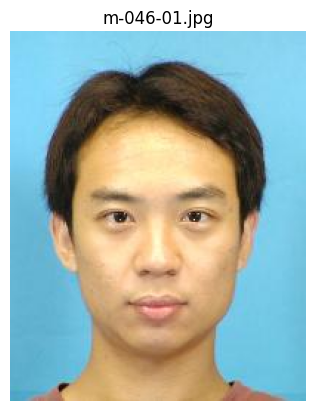

m-046-01.jpg - (200, 250)


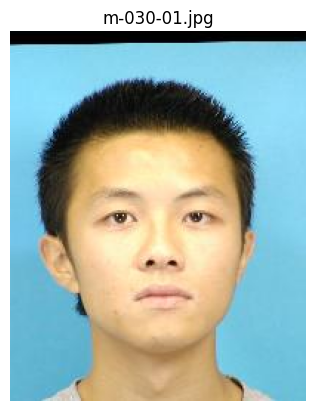

m-030-01.jpg - (200, 250)


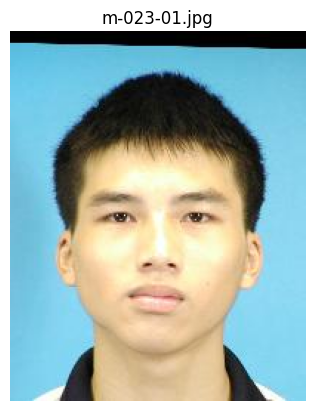

m-023-01.jpg - (200, 250)


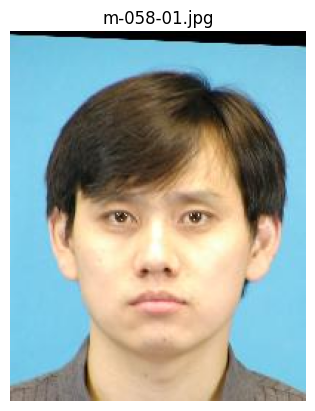

m-058-01.jpg - (200, 250)


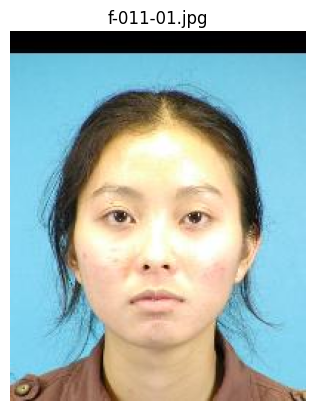

f-011-01.jpg - (200, 250)


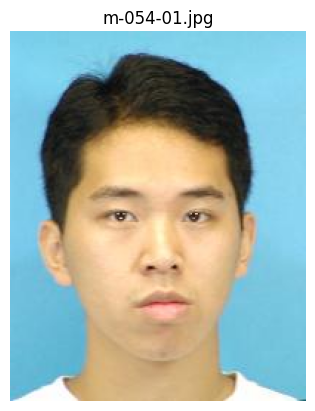

m-054-01.jpg - (200, 250)


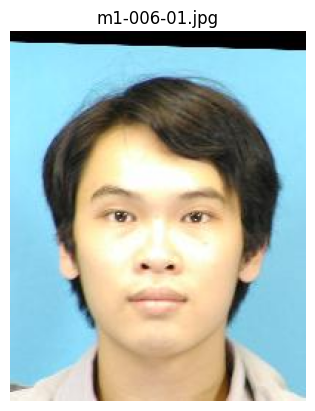

m1-006-01.jpg - (200, 250)


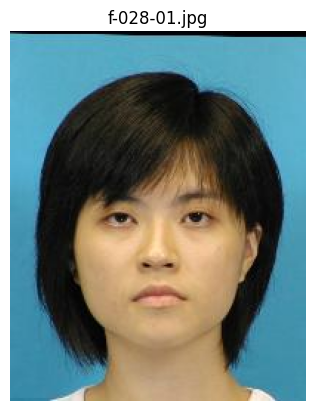

f-028-01.jpg - (200, 250)


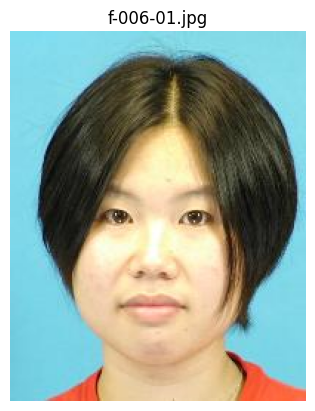

f-006-01.jpg - (200, 250)


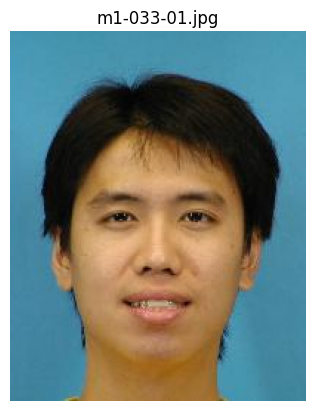

m1-033-01.jpg - (200, 250)


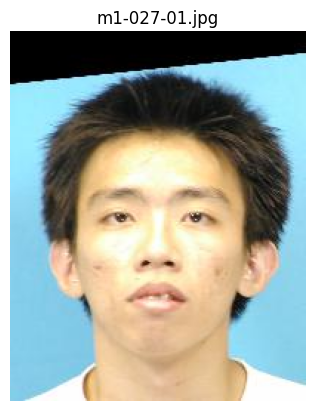

m1-027-01.jpg - (200, 250)


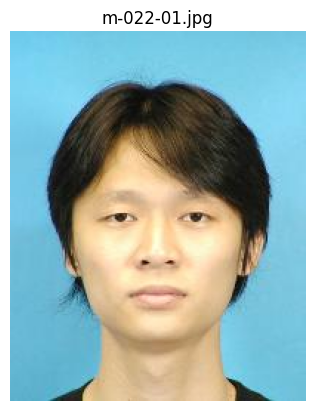

m-022-01.jpg - (200, 250)


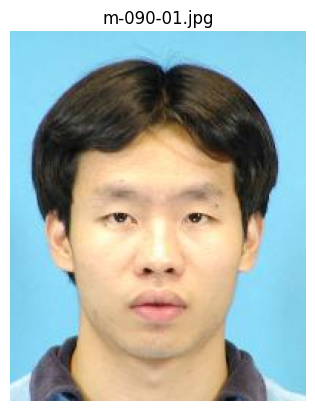

m-090-01.jpg - (200, 250)


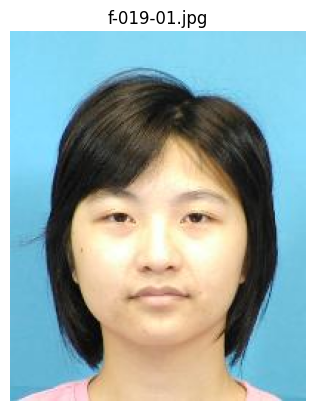

f-019-01.jpg - (200, 250)


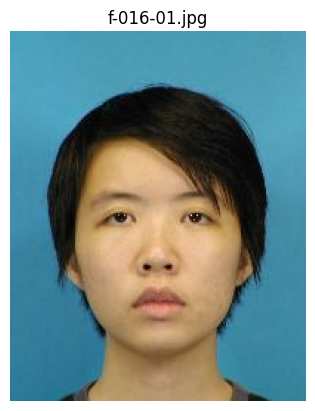

f-016-01.jpg - (200, 250)


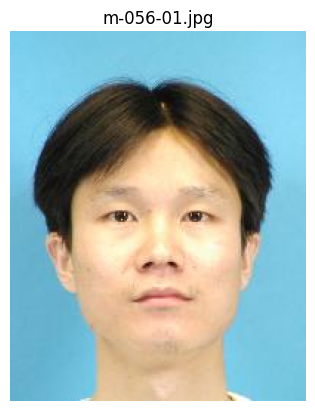

m-056-01.jpg - (200, 250)


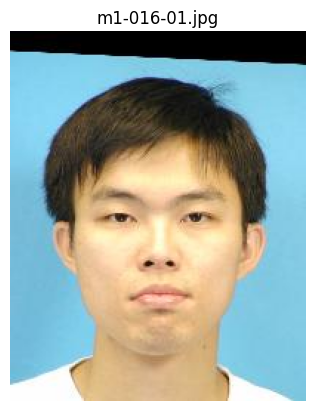

m1-016-01.jpg - (200, 250)


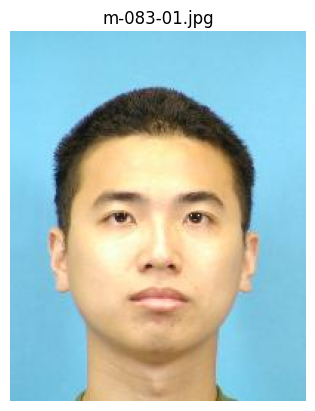

m-083-01.jpg - (200, 250)


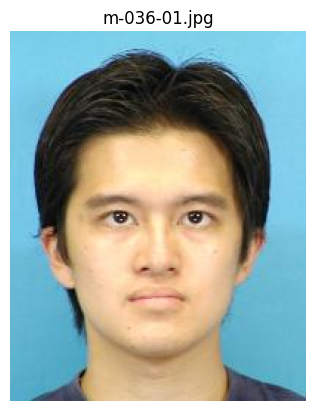

m-036-01.jpg - (200, 250)


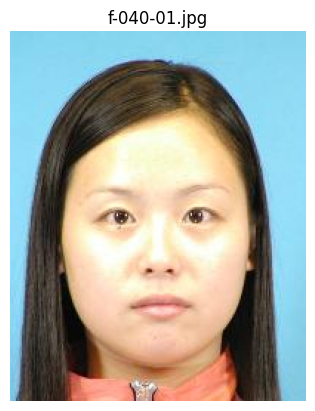

f-040-01.jpg - (200, 250)


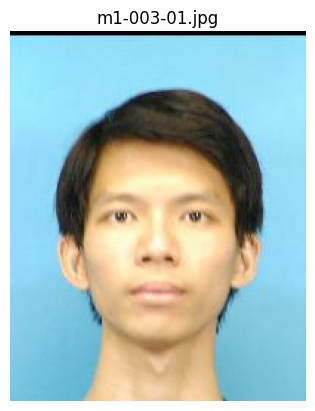

m1-003-01.jpg - (200, 250)


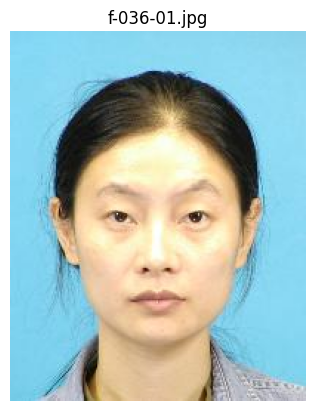

f-036-01.jpg - (200, 250)


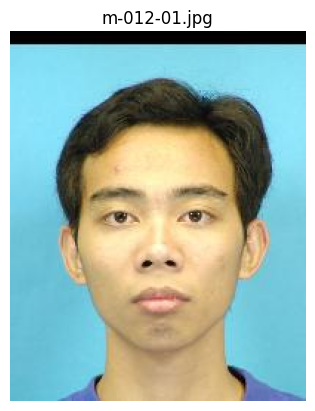

m-012-01.jpg - (200, 250)


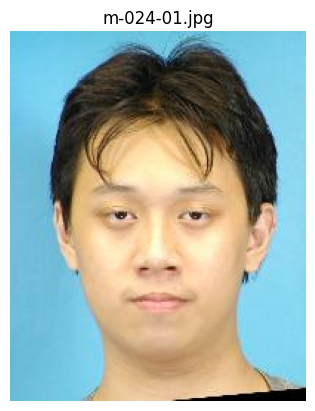

m-024-01.jpg - (200, 250)


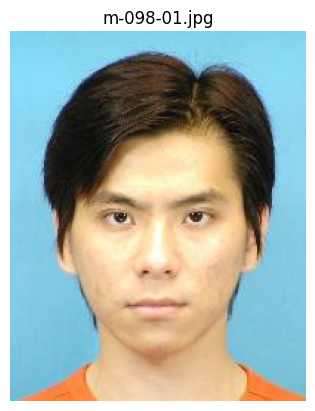

m-098-01.jpg - (200, 250)


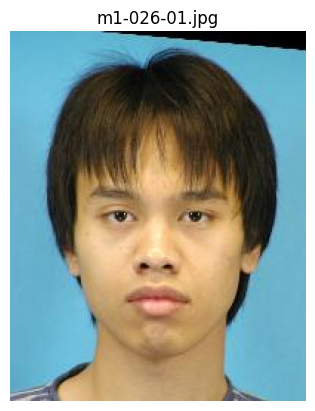

m1-026-01.jpg - (200, 250)


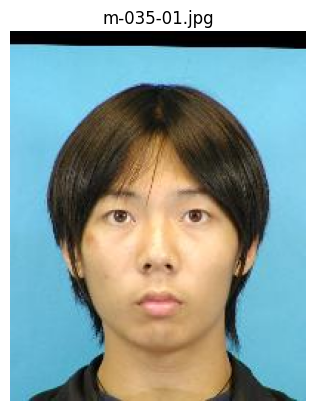

m-035-01.jpg - (200, 250)


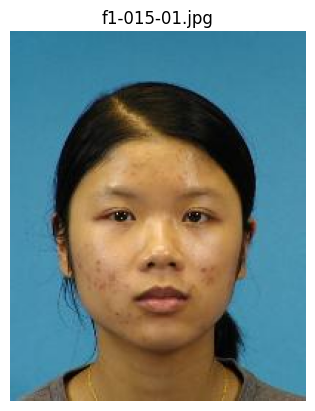

f1-015-01.jpg - (200, 250)


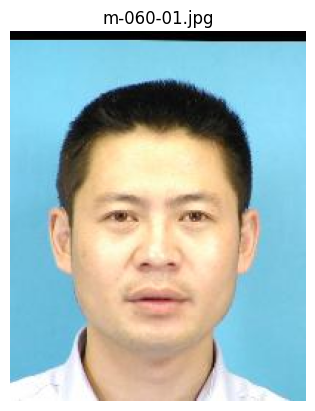

m-060-01.jpg - (200, 250)


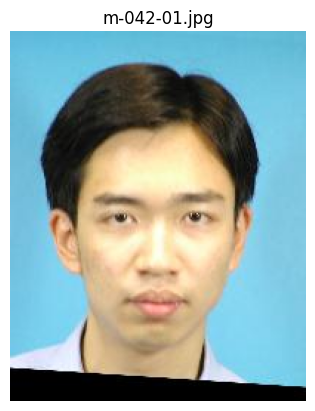

m-042-01.jpg - (200, 250)


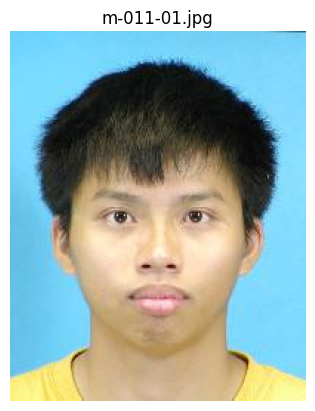

m-011-01.jpg - (200, 250)


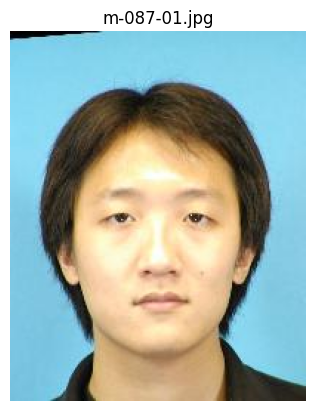

m-087-01.jpg - (200, 250)


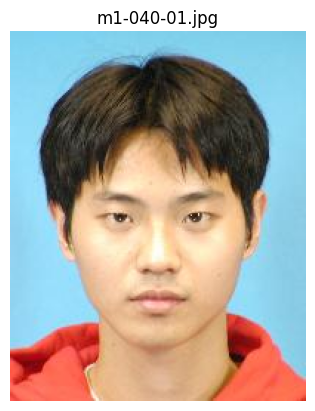

m1-040-01.jpg - (200, 250)


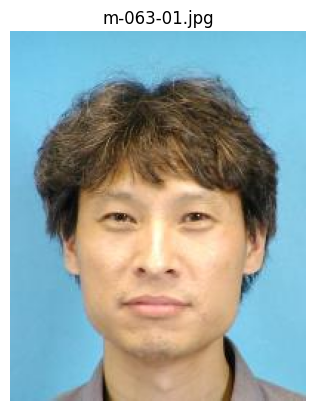

m-063-01.jpg - (200, 250)


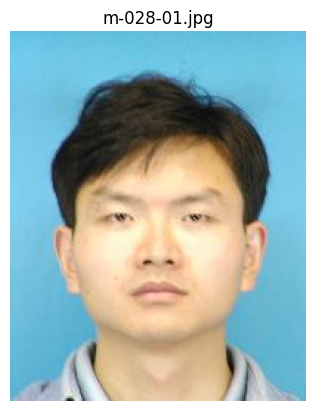

m-028-01.jpg - (200, 250)


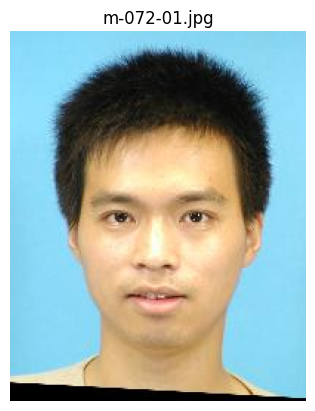

m-072-01.jpg - (200, 250)


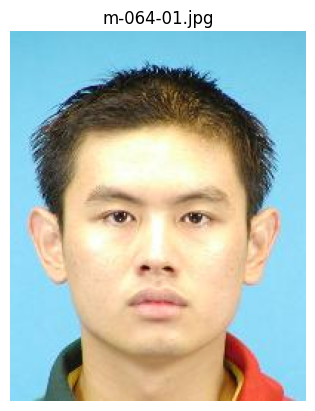

m-064-01.jpg - (200, 250)


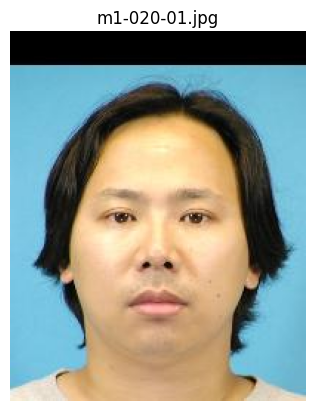

m1-020-01.jpg - (200, 250)


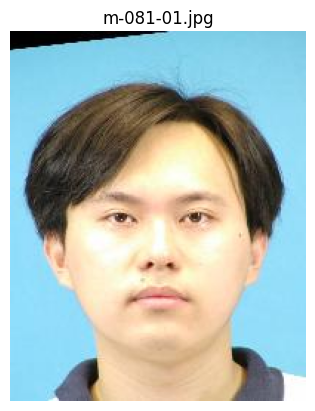

m-081-01.jpg - (200, 250)


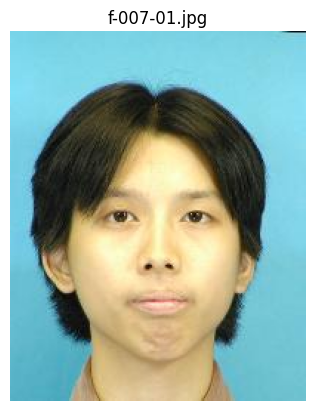

f-007-01.jpg - (200, 250)


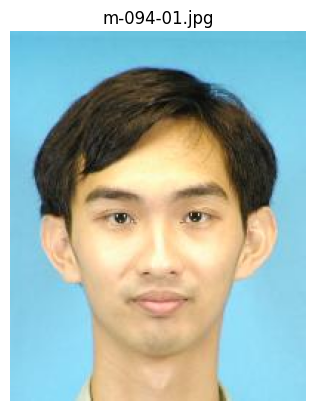

m-094-01.jpg - (200, 250)


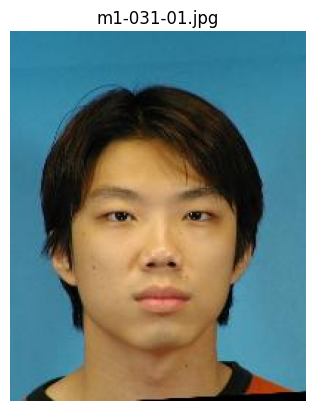

m1-031-01.jpg - (200, 250)


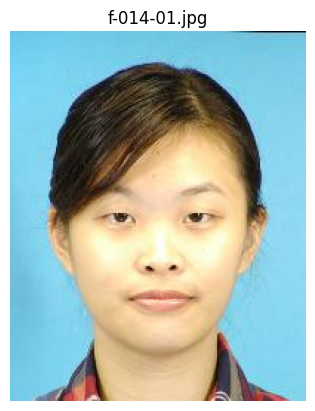

f-014-01.jpg - (200, 250)


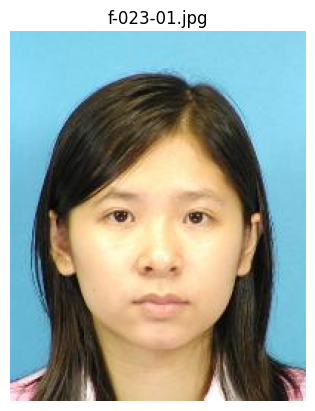

f-023-01.jpg - (200, 250)


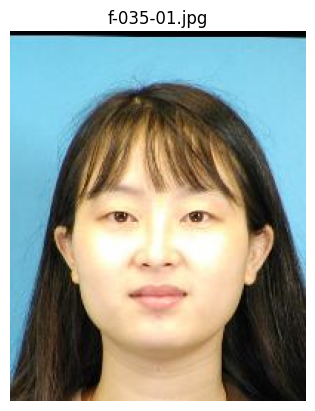

f-035-01.jpg - (200, 250)


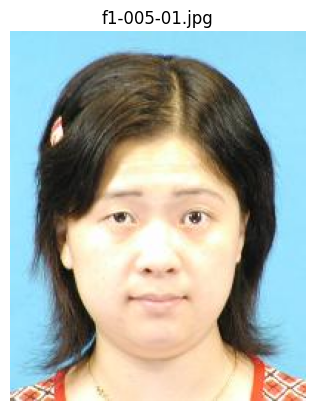

f1-005-01.jpg - (200, 250)


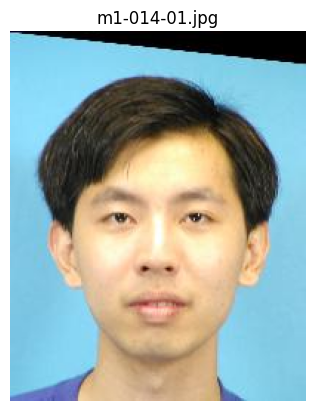

m1-014-01.jpg - (200, 250)


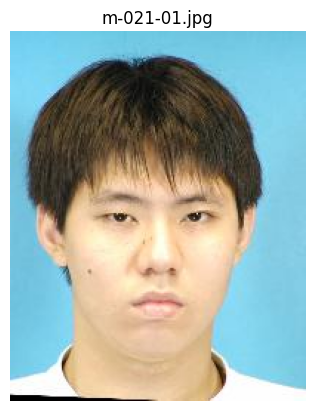

m-021-01.jpg - (200, 250)


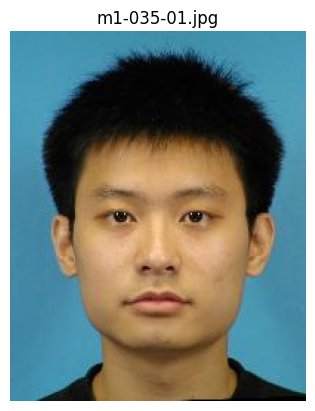

m1-035-01.jpg - (200, 250)


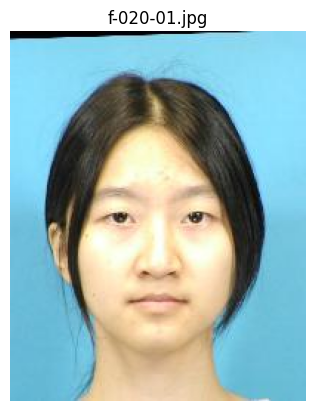

f-020-01.jpg - (200, 250)


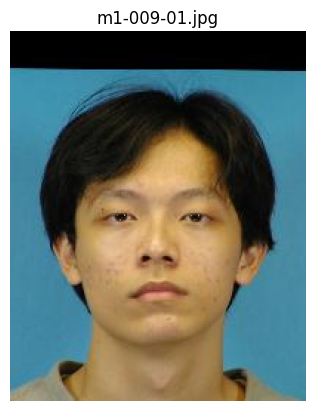

m1-009-01.jpg - (200, 250)


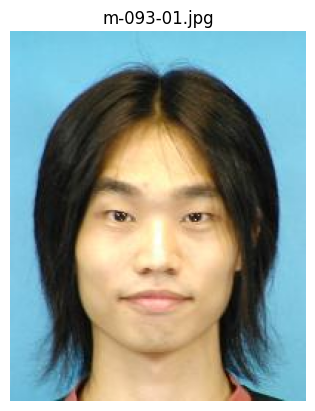

m-093-01.jpg - (200, 250)


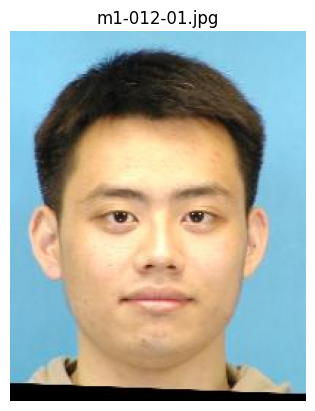

m1-012-01.jpg - (200, 250)


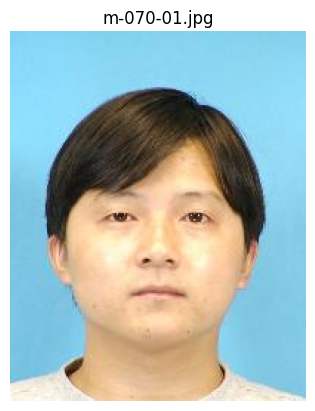

m-070-01.jpg - (200, 250)


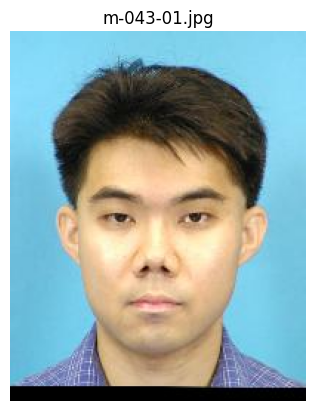

m-043-01.jpg - (200, 250)


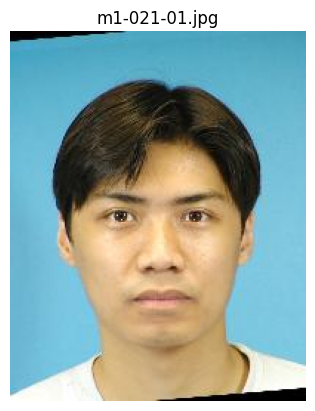

m1-021-01.jpg - (200, 250)


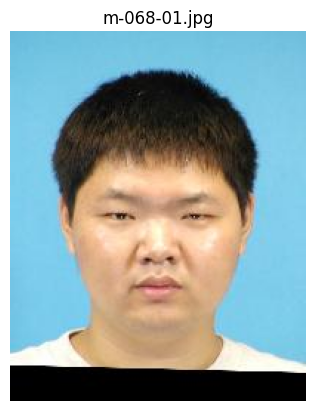

m-068-01.jpg - (200, 250)


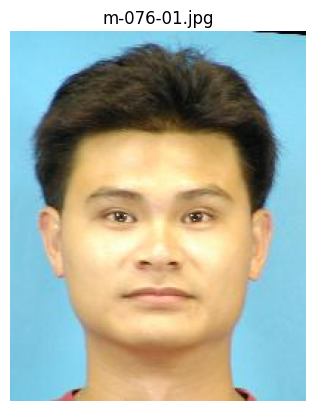

m-076-01.jpg - (200, 250)


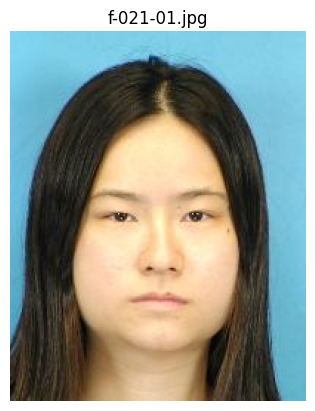

f-021-01.jpg - (200, 250)


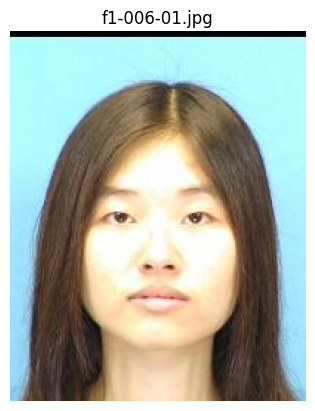

f1-006-01.jpg - (200, 250)


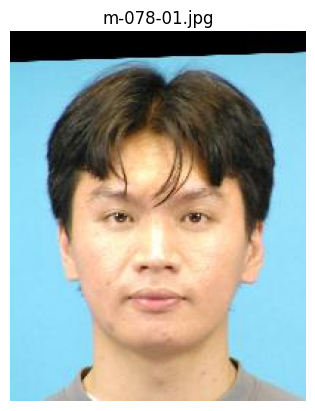

m-078-01.jpg - (200, 250)


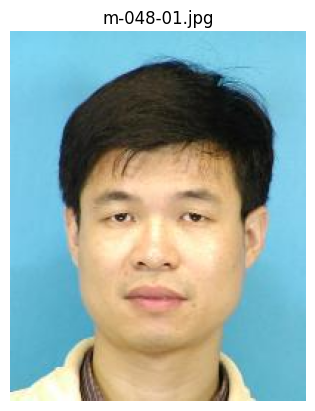

m-048-01.jpg - (200, 250)


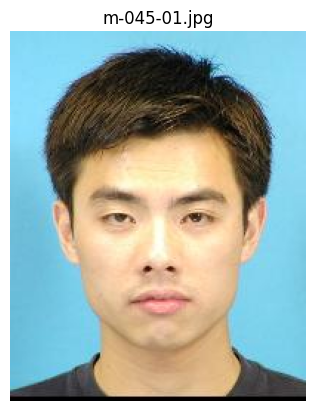

m-045-01.jpg - (200, 250)


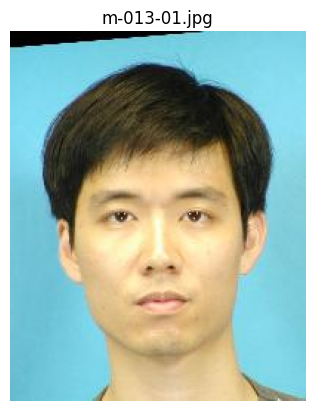

m-013-01.jpg - (200, 250)


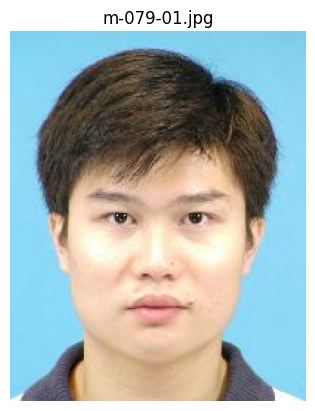

m-079-01.jpg - (200, 250)


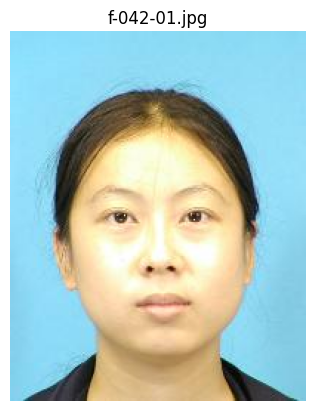

f-042-01.jpg - (200, 250)


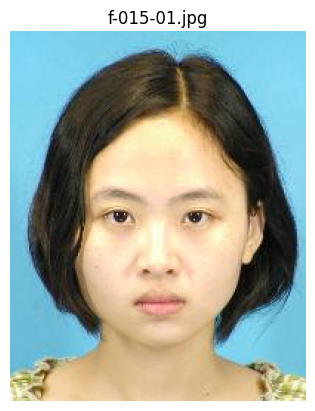

f-015-01.jpg - (200, 250)


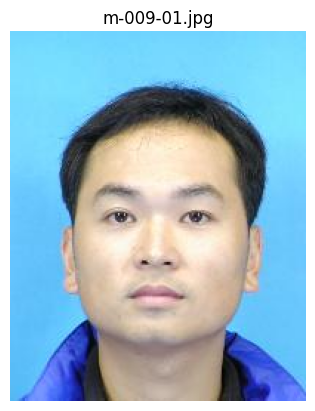

m-009-01.jpg - (200, 250)


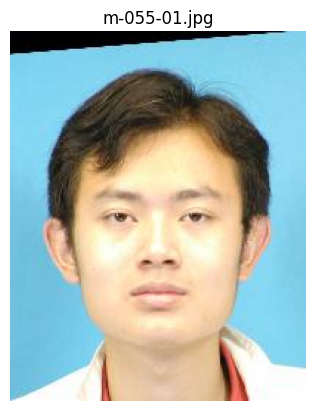

m-055-01.jpg - (200, 250)


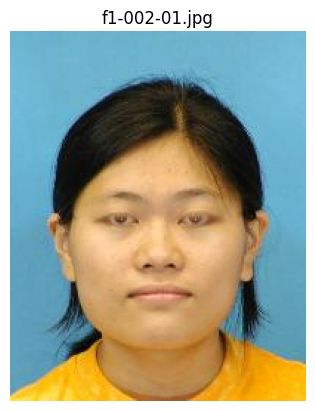

f1-002-01.jpg - (200, 250)


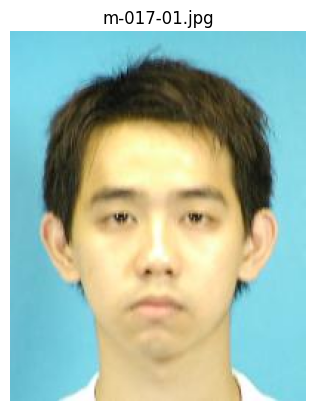

m-017-01.jpg - (200, 250)


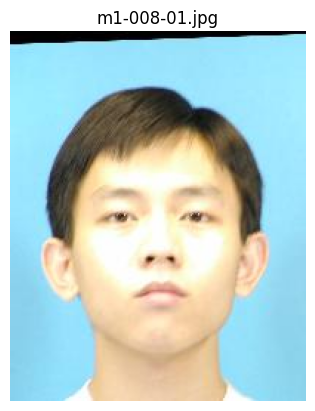

m1-008-01.jpg - (200, 250)


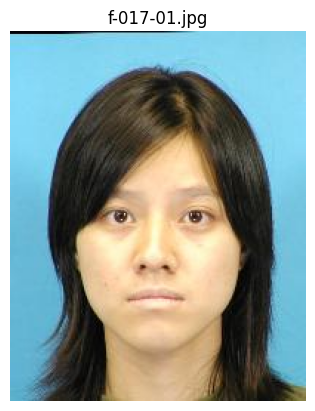

f-017-01.jpg - (200, 250)


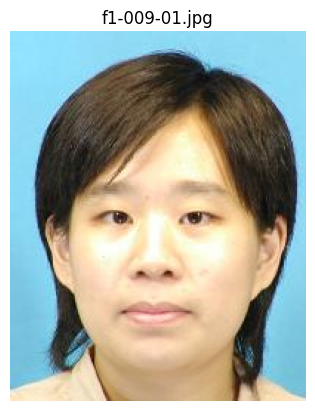

f1-009-01.jpg - (200, 250)


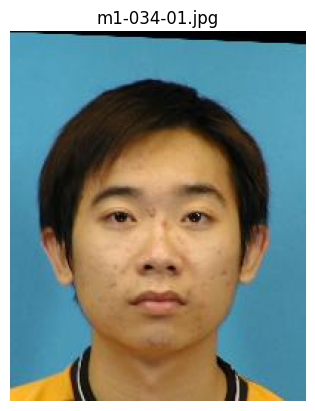

m1-034-01.jpg - (200, 250)


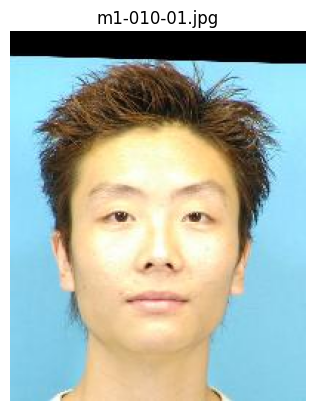

m1-010-01.jpg - (200, 250)


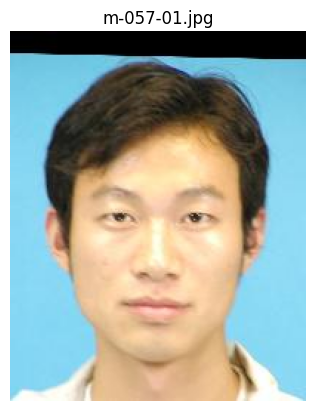

m-057-01.jpg - (200, 250)


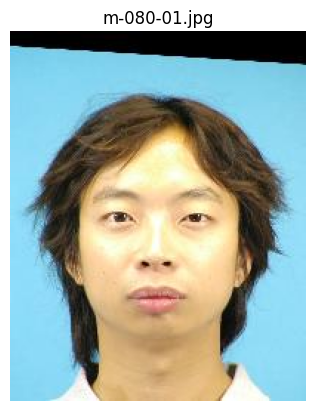

m-080-01.jpg - (200, 250)


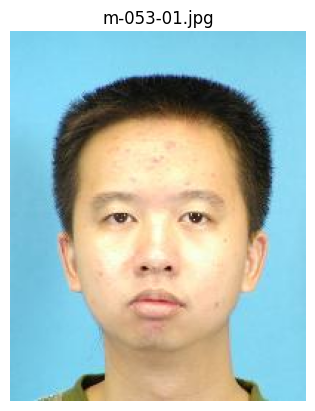

m-053-01.jpg - (200, 250)


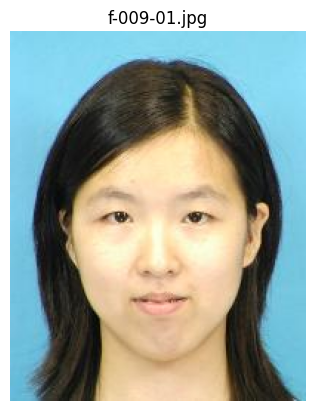

f-009-01.jpg - (200, 250)


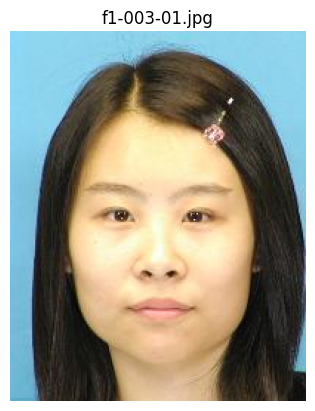

f1-003-01.jpg - (200, 250)


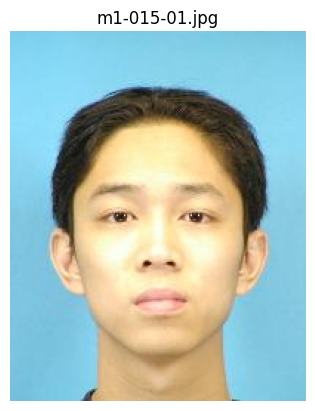

m1-015-01.jpg - (200, 250)


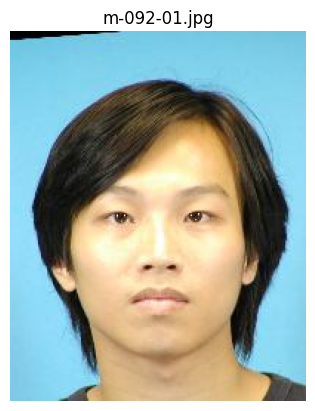

m-092-01.jpg - (200, 250)


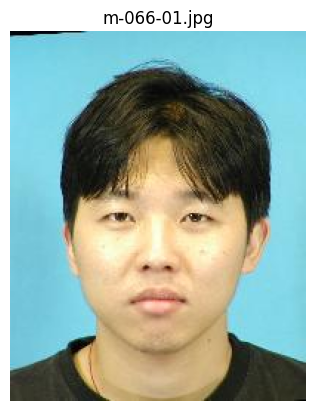

m-066-01.jpg - (200, 250)


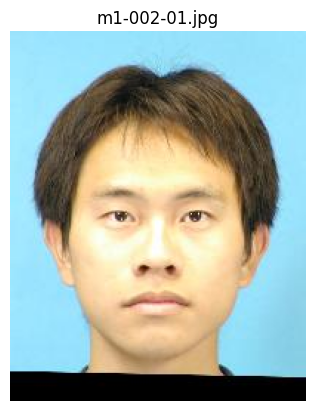

m1-002-01.jpg - (200, 250)


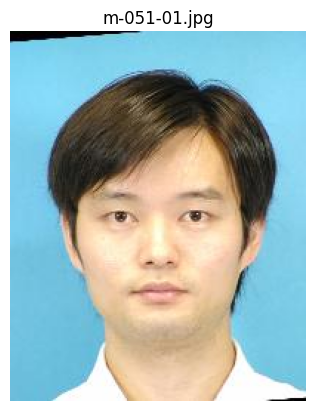

m-051-01.jpg - (200, 250)


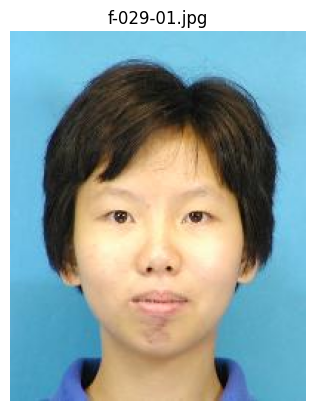

f-029-01.jpg - (200, 250)


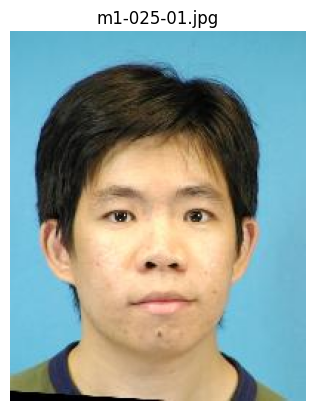

m1-025-01.jpg - (200, 250)


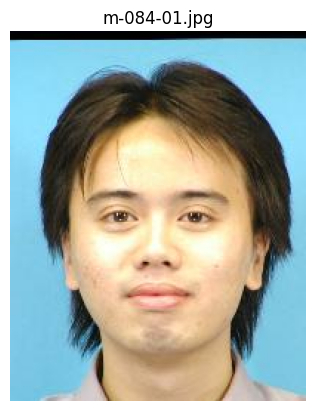

m-084-01.jpg - (200, 250)


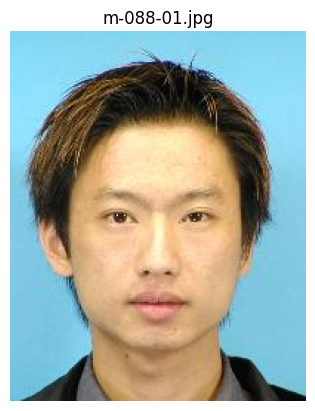

m-088-01.jpg - (200, 250)


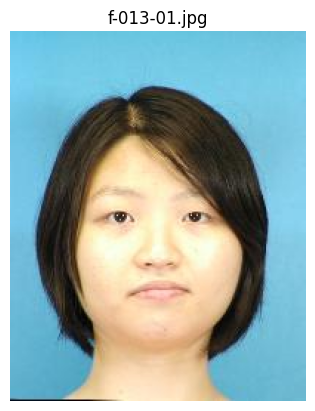

f-013-01.jpg - (200, 250)


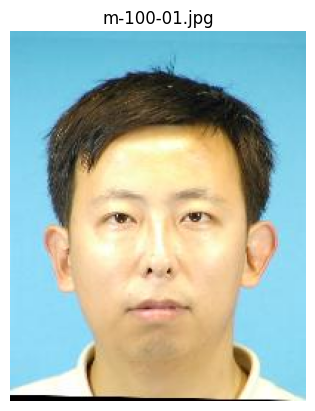

m-100-01.jpg - (200, 250)


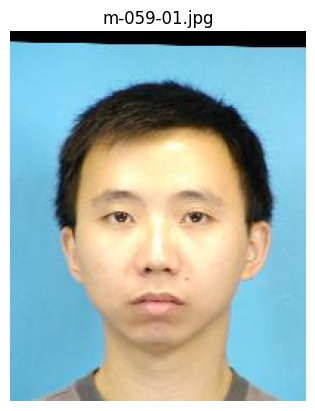

m-059-01.jpg - (200, 250)


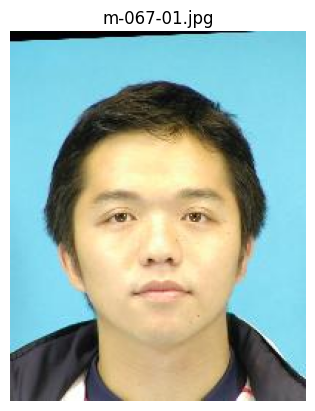

m-067-01.jpg - (200, 250)


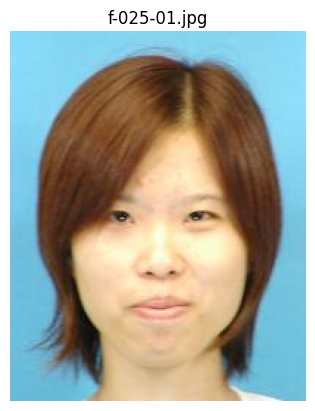

f-025-01.jpg - (200, 250)


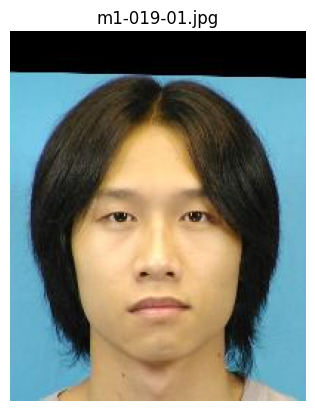

m1-019-01.jpg - (200, 250)


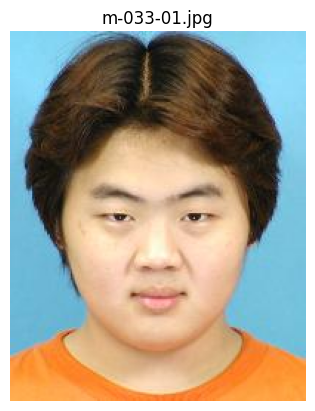

m-033-01.jpg - (200, 250)


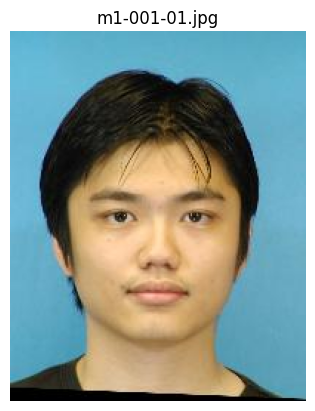

m1-001-01.jpg - (200, 250)


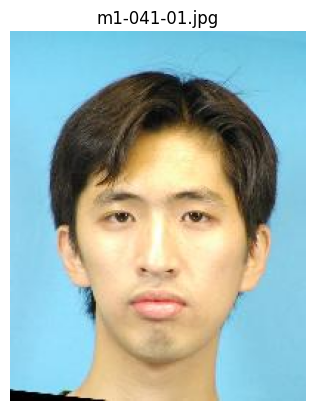

m1-041-01.jpg - (200, 250)


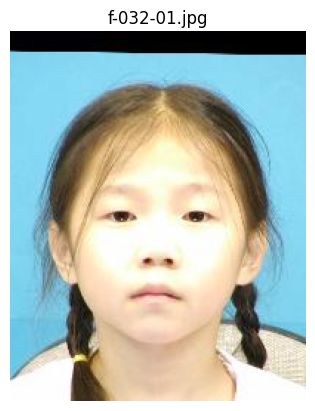

f-032-01.jpg - (200, 250)


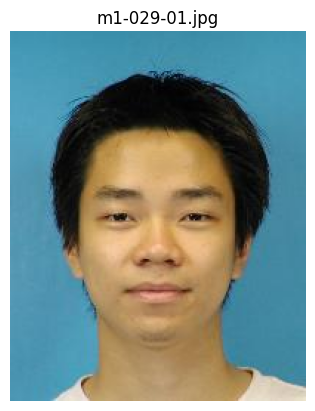

m1-029-01.jpg - (200, 250)


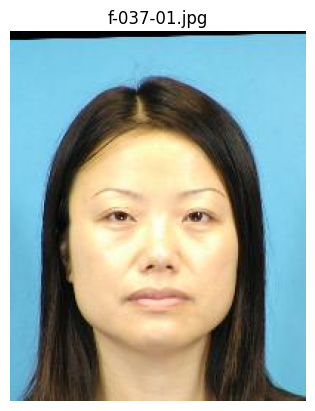

f-037-01.jpg - (200, 250)


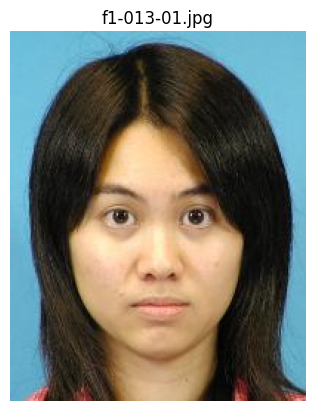

f1-013-01.jpg - (200, 250)


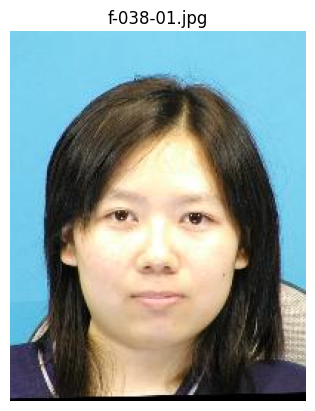

f-038-01.jpg - (200, 250)


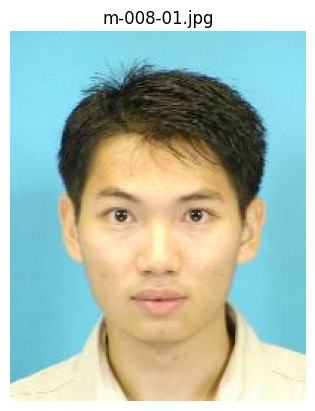

m-008-01.jpg - (200, 250)


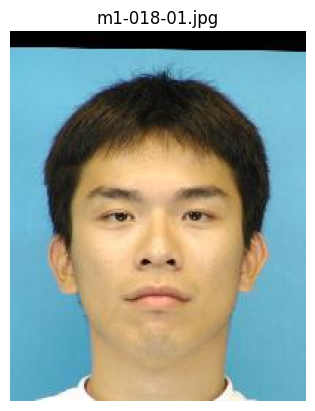

m1-018-01.jpg - (200, 250)


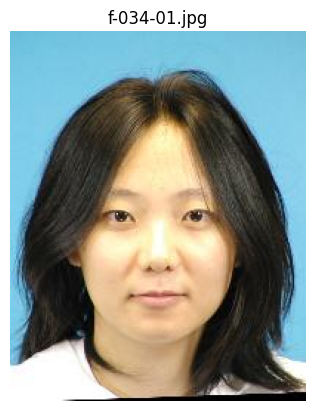

f-034-01.jpg - (200, 250)


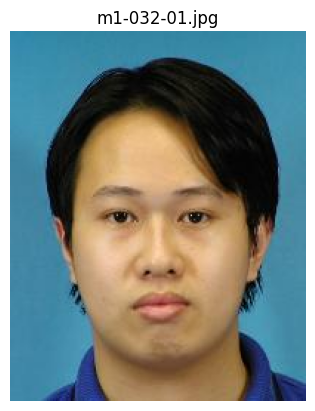

m1-032-01.jpg - (200, 250)


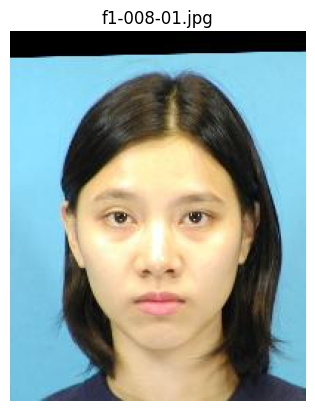

f1-008-01.jpg - (200, 250)


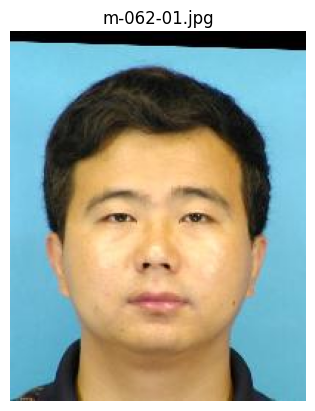

m-062-01.jpg - (200, 250)


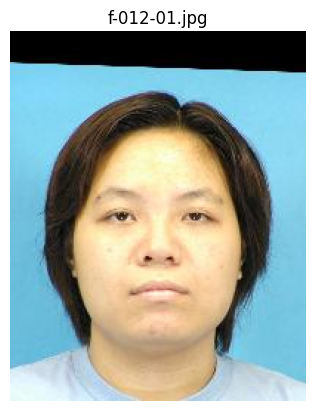

f-012-01.jpg - (200, 250)


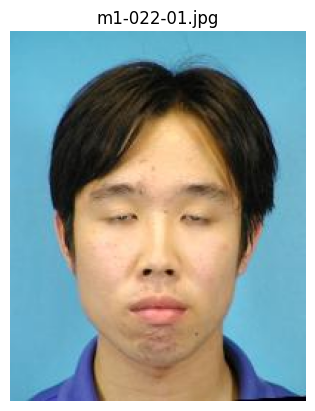

m1-022-01.jpg - (200, 250)


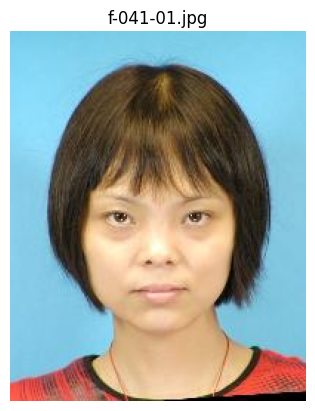

f-041-01.jpg - (200, 250)


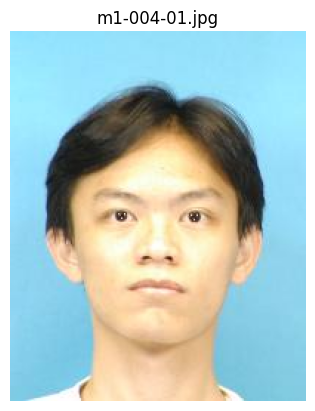

m1-004-01.jpg - (200, 250)


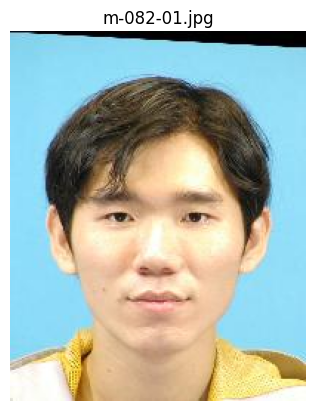

m-082-01.jpg - (200, 250)


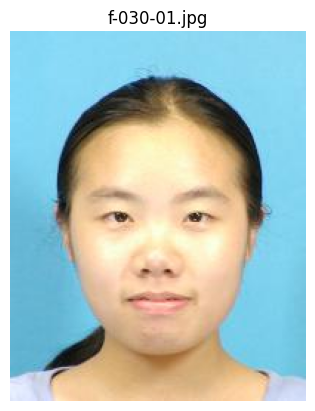

f-030-01.jpg - (200, 250)


In [6]:
# Exibindo as imagens de files_in_photos

import matplotlib.image as mpimg
from PIL import Image

def show_images(folder_path):
    """Exibe todas as imagens em uma pasta."""
    sizes = []
    for filename in os.listdir(folder_path):
        filepath = os.path.join(folder_path, filename)
        if os.path.isfile(filepath):
            try:
                img = Image.open(filepath)
                plt.imshow(img)
                plt.title(filename)
                plt.axis('off')  # Oculta os eixos
                plt.show()
                sizes.append(img.size)
                print(f"{filename} - {img.size}")  # Mostra o tamanho (altura, largura)
            except Exception as e:
                print(f"Erro ao exibir {filename}: {e}")
    return sizes

all_sizes = show_images(photos_folder)




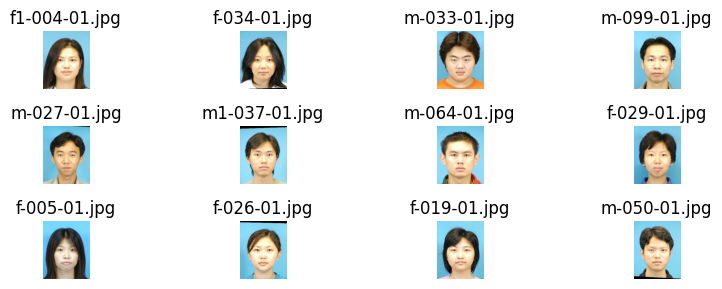

In [7]:
# Exibição de 12 imagens aleatórias do dataset em 3 linhas e 4 colunas

import random

# Selecione aleatoriamente 12 imagens
num_images_to_display = 12
random_image_files = random.sample(files_in_photos, min(num_images_to_display, len(files_in_photos)))

# Crie uma grade para exibir as imagens
rows = 3
cols = 4
fig, axes = plt.subplots(rows, cols, figsize=(9, 3))

for i, filename in enumerate(random_image_files):
    filepath = os.path.join(photos_folder, filename)
    try:
        img = mpimg.imread(filepath)
        row = i // cols
        col = i % cols
        axes[row, col].imshow(img)
        axes[row, col].set_title(filename)
        axes[row, col].axis('off')
    except FileNotFoundError:
        print(f"Erro: Arquivo não encontrado em {filepath}")
    except Exception as e:
        print(f"Erro exibindo {filename}: {e}")

plt.tight_layout()
plt.show()

### Criando lista com rótulos de classe

Rótulos de classe para cada arquivo de imagem: 0 - Masculino e 1 - Feminino

In [25]:
def create_class_labels(image_filenames):
  """Cria uma lista de rótulos de classe com base nos nomes dos arquivos de imagem."""
  labels = []
  for filename in image_filenames:
    # Se começar com m, o valor atribuído será 0
    if filename.startswith('m'):
      labels.append(0)
    # Se começar com f, o valor atribuído será 1
    elif filename.startswith('f'):
      labels.append(1)
    else:
      # Casos em que os nomes dos arquivos não começam com 'm' ou 'f'
      labels.append(-1)
  return labels

# Criando a lista com os rótulos
class_labels = create_class_labels(files_in_photos)

print(class_labels)
print("Total: ", len(class_labels))
print("Zeros (homens):", class_labels.count(0))
print("Uns (mulheres):", class_labels.count(1))

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1]
Total:  188
Zeros (homens): 134
Uns (mulheres): 54


### Ajustar as dimensões das imagens para um tamanho uniforme

Garantir que todas as imagens tenham o tamanho uniforme de 200x250 pixels (largura x altura)

In [9]:
# Verificando quantas imagens possuem o tamanho (200, 250)

count = all_sizes.count((200, 250))
print(f"Número de imagens com tamanho (200, 250): {count}")


Número de imagens com tamanho (200, 250): 188


(188, 250, 200, 3)


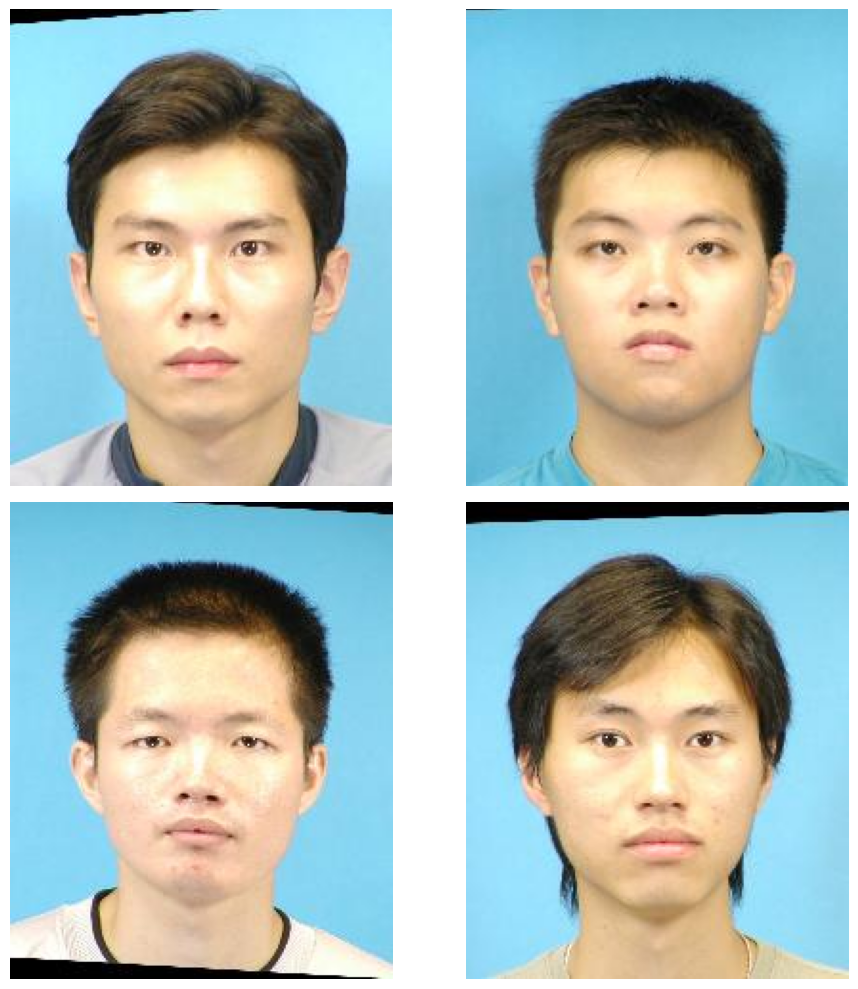

In [26]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf

# Caminho da pasta onde estão as imagens
photos_folder = "photos"

# Defina o tamanho desejado para redimensionamento
target_size = (200, 250)  # 200 largura x 250 altura

# Lista de imagens
image_paths = [os.path.join(photos_folder, fname) for fname in os.listdir(photos_folder) if fname.endswith(('.png', '.jpg', '.jpeg'))]

# Lista para armazenar as imagens redimensionadas
resized_images = []

# Carregar e redimensionar as imagens
for image_path in image_paths:
    # Abrir a imagem
    img = Image.open(image_path)

    # Redimensionar a imagem
    img_resized = img.resize(target_size)

    # Converter para array numpy
    img_array = np.array(img_resized)

    # Adicionar a imagem redimensionada à lista
    resized_images.append(img_array)

# Converter a lista para um array numpy
X_resized = np.array(resized_images)

# Verificar o formato final das imagens
print(X_resized.shape)  # Esperado: (n_samples, 250, 200, 3)
#print(X_resized)

# Definir o número de imagens a serem exibidas
num_images = 4

# Configurar a visualização com 2 linhas e 2 colunas (uma grade de 2x2)
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

# Iterar sobre as imagens e os eixos da grade
for i, ax in enumerate(axes.flat):
    if i < num_images:
        # Exibir a imagem
        ax.imshow(X_resized[i])  # Exibe a i-ésima imagem
        ax.axis('off')  # Desabilitar os eixos

# Ajustar o layout para não sobrepor as imagens
plt.tight_layout()
plt.show()

### Normalizando os valores

Dividindo os valores RGB das imagens por 255 para que fiquem entre 0 e 1.

In [27]:
X = X_resized / 255.0
X = np.array(X)  # Converter lista para array NumPy
#print(X)
print(f"Máximo valor em X: {X.max()}")
print(f"Mínimo valor em X: {X.min()}")

Máximo valor em X: 1.0
Mínimo valor em X: 0.0


### Dividindo o dataset para o modelo



*   50% para o conjunto de treinamento;
*   30% para o conjunto de validação;
*   20% para o conjunto de teste.

Foi criado um conjunto temporário para armazenar os 50% do dataset que não foi pra treinamento e que seria então dividido em validação e teste.

O conjunto temporário teve 94 imagens, que representavam os 50% restantes do total. Para atingir a proporção final de 30% para validação e 20% para teste:

30% / (30% + 20%) = 3/5 → Validação recebe 60% do conjunto temporário.

20% / (30% + 20%) = 2/5 → Teste recebe 40% do conjunto temporário.

In [28]:
from sklearn.model_selection import train_test_split

# Fixar a seed
random.seed(23)
np.random.seed(23)
tf.random.set_seed(23)

y = class_labels
y = np.array(y) # Rótulos das imagens

# Defina a seed
seed = 23

# Aumentando o dataset
#X = np.concatenate([X] * 4)
#y = np.concatenate([y] * 4)

# Divida em treinamento (50%) e o restante (50%)
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.5, random_state=seed)

# Divida o restante em validação (30% do total original) e teste (20% do total original)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.4, random_state=seed)

# Verificação dos tamanhos
print("Tamanho do conjunto de treinamento:", len(X_train))
print("Tamanho do conjunto de validação:", len(X_val))
print("Tamanho do conjunto de teste:", len(X_test))

Tamanho do conjunto de treinamento: 94
Tamanho do conjunto de validação: 56
Tamanho do conjunto de teste: 38


# 2. Modelo CNN

### Balanceamento dos dados

Temos mais imagens do sexo masculino do que do sexo feminino. Então é necessário balancear os dados.

In [29]:
from imblearn.over_sampling import SMOTE

# Reshape X_train to 2D: (samples, features)
num_samples = X_train.shape[0]
num_features = X_train.shape[1] * X_train.shape[2] * X_train.shape[3]
X_train_reshaped = X_train.reshape(num_samples, num_features)

# Apply SMOTE
smote = SMOTE(random_state=42)
X_train_balanced_reshaped, y_train_balanced = smote.fit_resample(X_train_reshaped, y_train)

# Reshape X_train_balanced back to 4D: (samples, height, width, channels)
X_train_balanced = X_train_balanced_reshaped.reshape(X_train_balanced_reshaped.shape[0], X_train.shape[1], X_train.shape[2], X_train.shape[3])

"""X_train_balanced = np.concatenate([X_train_balanced] * 4)
y_train_balanced = np.concatenate([y_train_balanced] * 4)"""

# Verificações de dados
print("Shapes originais:")
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

print("\nShapes após SMOTE:")
print("X_train_balanced shape:", X_train_balanced.shape)
print("y_train_balanced shape:", y_train_balanced.shape)

# Verificação de distribuição de classes
print("\nDistribuição de classes:")
print("Classe masculina (0):", sum(y_train_balanced == 0))
print("Classe feminina (1):", sum(y_train_balanced == 1))


Shapes originais:
X_train shape: (94, 250, 200, 3)
y_train shape: (94,)

Shapes após SMOTE:
X_train_balanced shape: (138, 250, 200, 3)
y_train_balanced shape: (138,)

Distribuição de classes:
Classe masculina (0): 69
Classe feminina (1): 69


### Configurando a arquitetura do modelo

In [30]:
import tensorflow as tf
from tensorflow.keras import models, layers
from tensorflow.keras.regularizers import l2

# Modelo CNN
model = models.Sequential()

# Camadas convolucionais
model.add(tf.keras.Input(shape=(250, 200, 3)))
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.001)))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.3))

model.add(layers.Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.001)))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.3))
'''
model.add(layers.Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.001)))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(0.3))
'''
# Camadas densas
model.add(layers.Flatten())
#model.add(layers.Dense(128, activation='relu', kernel_regularizer=l2(0.001)))
#model.add(layers.Dropout(0.5))

model.add(layers.Dense(64, activation='relu', kernel_regularizer=l2(0.001)))
model.add(layers.Dropout(0.5))

# Camada de Saída
model.add(layers.Dense(1, activation='sigmoid'))


### Treinando o modelo

In [31]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score

# Fixar a seed
random.seed(23)
np.random.seed(23)
tf.random.set_seed(23)

#class_weights = {0: 1.0, 1: 5.0}  # Ajuste mais peso para classe feminina
# Pesos dinâmicos
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(
    'balanced',
    classes=np.unique(y_train_balanced),
    y=y_train_balanced
)
class_weights = dict(enumerate(class_weights))

# Configure o data generator
datagen = ImageDataGenerator(
    rotation_range=30,      # Aumente o range de rotação
    width_shift_range=0.3,  # Aumente o deslocamento
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True,
    vertical_flip=False,    # Evite virar verticalmente
    brightness_range=[0.8, 1.2]  # Variação de brilho
)
# o conjunto de dados é pequeno
batch_size = 8

# Configurar os folds da validação cruzada
n_splits = 3  # Número de folds
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=23)

# Configuração da condição de parada
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True
)

# Preparar arrays para armazenar os resultados
accuracy_per_fold = []
loss_per_fold = []
f1_scores = []

for train_index, val_index in skf.split(X_train_balanced, y_train_balanced):
    print(f"Distribuição em treino: {np.bincount(y_train_balanced[train_index])}")
    print(f"Distribuição em validação: {np.bincount(y_train_balanced[val_index])}")

    # Dividir os dados balanceados
    X_train_fold, X_val_fold = X_train_balanced[train_index], X_train_balanced[val_index]
    y_train_fold, y_val_fold = y_train_balanced[train_index], y_train_balanced[val_index]

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
        loss='binary_crossentropy',
        metrics=['accuracy', 'precision', 'recall']
    )
    # Data Augmentation apenas no treino
    datagen.fit(X_train_fold)

    # Isso impede que os steps sejam definidos como zero e evita o erro.
    steps_per_epoch = len(X_train_fold) // batch_size
    validation_steps = len(X_val_fold) // batch_size

    if steps_per_epoch == 0:
        steps_per_epoch = 1

    if validation_steps == 0:
        validation_steps = 1

    train_generator = datagen.flow(X_train_fold, y_train_fold, batch_size=batch_size, seed=23, shuffle=True)

    # Treinar o modelo
    history = model.fit(
        train_generator,
        validation_data=(X_val_fold, y_val_fold),
        epochs=30,
        steps_per_epoch=len(X_train_fold) // batch_size,
        validation_steps=len(X_val_fold) // batch_size,
        class_weight=class_weights,
        callbacks=[early_stopping]
    )

    # Avaliar o desempenho no fold atual
    scores = model.evaluate(X_val_fold, y_val_fold, verbose=0)
    accuracy_per_fold.append(scores[1])  # Acurácia
    loss_per_fold.append(scores[0])      # Perda

    # Calcular o F1-Score
    y_pred_fold = (model.predict(X_val_fold) > 0.5).astype(int)
    f1 = f1_score(y_val_fold, y_pred_fold)
    f1_scores.append(f1)

    print(f"steps_per_epoch: {steps_per_epoch}")
    print(f"validation_steps: {validation_steps}")
    print("Tamanho de X_train_fold:", len(X_train_fold))
    print("Tamanho de y_train_fold:", len(y_train_fold))
    print("Batch size:", batch_size)
    print("Steps por época:", len(X_train_fold) // batch_size)

    print(f"Fold concluído. Acurácia: {scores[1]:.4f}, F1-Score: {f1:.4f}")


print(f"Resultados da Validação Cruzada ({n_splits} folds):")
print(f"Loss média: {np.mean(loss_per_fold):.4f}")
print(f"Acurácia média: {np.mean(accuracy_per_fold):.4f}")
print(f"F1-Score médio: {np.mean(f1_scores):.4f}")

Distribuição em treino: [46 46]
Distribuição em validação: [23 23]
Epoch 1/30


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


11/11 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.4415 - loss: 29.7050 - precision: 0.3855 - recall: 0.3498 - val_accuracy: 0.5000 - val_loss: 18.1805 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.6250 - loss: 10.8496 - precision: 1.0000 - recall: 0.4000
Epoch 3/30


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.10/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,loss,precision,recall
  current = self.get_monitor_value(logs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.4985 - loss: 38.6219 - precision: 0.3465 - recall: 0.3757 - val_accuracy: 0.5000 - val_loss: 65.1275 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 4/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.5000 - loss: 141.3156 - precision: 0.5714 - recall: 0.8000
Epoch 5/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step - accuracy: 0.5010 - loss: 46.7758 - precision: 0.4466 - recall: 0.6658 - val_accuracy: 0.5000 - val_loss: 79.5934 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 6/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.2500 - loss: 49.7831 - precision: 0.2000 - recall: 0.3333
Epoch 7/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 19s 1s/step - accuracy: 0.5444 - loss: 24.1617 - precision: 0.4838 - recall: 0.8129 - val_accuracy: 0.5000 - val_loss: 53.5348 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 8/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 3s 232ms/step - accuracy: 0.6250 - loss: 55.2976 - precision: 0.6667 - r

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


11/11 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.4610 - loss: 8.9943 - precision: 0.4639 - recall: 0.7010 - val_accuracy: 0.5000 - val_loss: 17.7117 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 2/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6250 - loss: 4.8901 - precision: 0.5714 - recall: 1.0000
Epoch 3/30


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.10/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,loss,precision,recall
  current = self.get_monitor_value(logs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - accuracy: 0.5904 - loss: 8.0740 - precision: 0.5685 - recall: 0.7381 - val_accuracy: 0.4565 - val_loss: 5.7668 - val_precision: 0.4000 - val_recall: 0.1739
Epoch 4/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7500 - loss: 2.8904 - precision: 0.8000 - recall: 0.8000
Epoch 5/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - accuracy: 0.5700 - loss: 7.1408 - precision: 0.5523 - recall: 0.6726 - val_accuracy: 0.5000 - val_loss: 5.6423 - val_precision: 0.5000 - val_recall: 0.3478
Epoch 6/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 4s 238ms/step - accuracy: 0.5000 - loss: 1.5501 - precision: 0.5000 - recall: 0.7500
Epoch 7/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - accuracy: 0.5220 - loss: 6.8396 - precision: 0.4474 - recall: 0.4859 - val_accuracy: 0.3696 - val_loss: 5.5132 - val_precision: 0.4118 - val_recall: 0.6087
Epoch 8/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.6250 - loss: 1.2797 - precision: 0.5000 - recall: 0.6667
Epoch 9/30
11/11 ━━━

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 421ms/step
steps_per_epoch: 11
validation_steps: 5
Tamanho de X_train_fold: 92
Tamanho de y_train_fold: 92
Batch size: 8
Steps por época: 11
Fold concluído. Acurácia: 0.3696, F1-Score: 0.4912
Distribuição em treino: [46 46]
Distribuição em validação: [23 23]
Epoch 1/30


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


11/11 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.5222 - loss: 3.5955 - precision: 0.5387 - recall: 0.7437 - val_accuracy: 0.5000 - val_loss: 4.5702 - val_precision: 0.5000 - val_recall: 0.0870
Epoch 2/30
 1/11 ━━━━━━━━━━━━━━━━━━━━ 42s 4s/step - accuracy: 0.5000 - loss: 3.6636 - precision: 0.5000 - recall: 0.5000

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


11/11 ━━━━━━━━━━━━━━━━━━━━ 7s 292ms/step - accuracy: 0.5000 - loss: 3.6636 - precision: 0.5000 - recall: 0.5000
Epoch 3/30


/usr/local/lib/python3.10/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,loss,precision,recall
  current = self.get_monitor_value(logs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - accuracy: 0.4853 - loss: 10.4619 - precision: 0.5668 - recall: 0.4550 - val_accuracy: 0.4565 - val_loss: 2.1646 - val_precision: 0.4615 - val_recall: 0.5217
Epoch 4/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.7500 - loss: 4.2782 - precision: 0.7500 - recall: 0.7500
Epoch 5/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - accuracy: 0.4777 - loss: 21.2105 - precision: 0.4987 - recall: 0.6532 - val_accuracy: 0.5000 - val_loss: 6.4174 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 6/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 4s 270ms/step - accuracy: 0.5000 - loss: 11.3646 - precision: 0.5000 - recall: 0.7500
Epoch 7/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - accuracy: 0.5114 - loss: 13.4465 - precision: 0.5290 - recall: 0.5744 - val_accuracy: 0.5000 - val_loss: 12.1030 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 8/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.6250 - loss: 5.5322 - precision: 1.0000 - recall: 0.2500
Epoch 9/30
11/1

# 3. Análise e Visualização dos resultados

### Visualizando os resultados

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 128ms/step


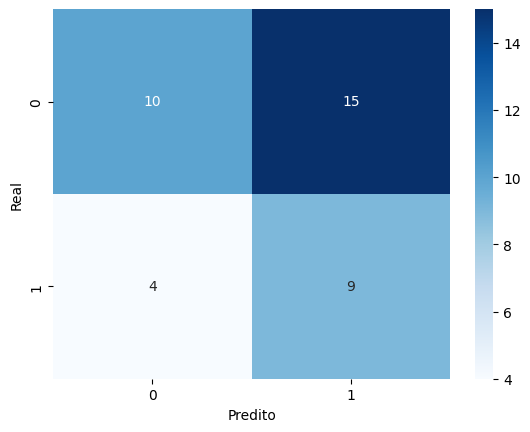

              precision    recall  f1-score   support

           0       0.71      0.40      0.51        25
           1       0.38      0.69      0.49        13

    accuracy                           0.50        38
   macro avg       0.54      0.55      0.50        38
weighted avg       0.60      0.50      0.50        38



In [32]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Predições
y_pred = model.predict(X_test)
y_pred_classes = (y_pred > 0.5).astype(int).flatten()


# Matriz de confusão
cm = confusion_matrix(y_test, y_pred_classes)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predito')
plt.ylabel('Real')
plt.show()

# Relatório de classificação
print(classification_report(y_test, y_pred_classes))


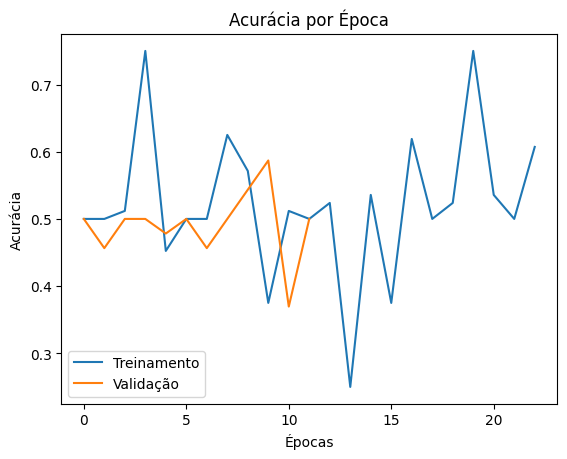

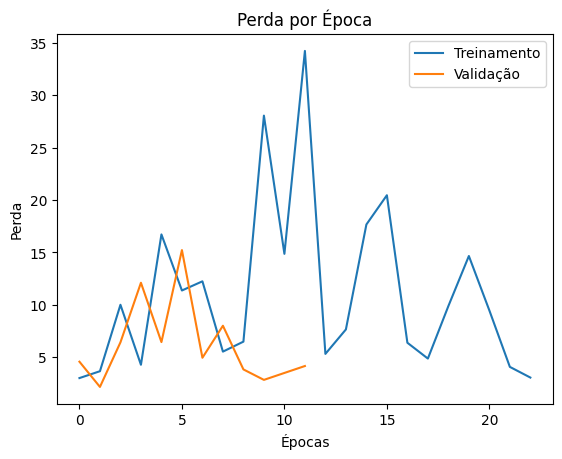

In [33]:
# Precisão
plt.plot(history.history['accuracy'], label='Treinamento')
plt.plot(history.history['val_accuracy'], label='Validação')
plt.title('Acurácia por Época')
plt.xlabel('Épocas')
plt.ylabel('Acurácia')
plt.legend()
plt.show()

# Perda
plt.plot(history.history['loss'], label='Treinamento')
plt.plot(history.history['val_loss'], label='Validação')
plt.title('Perda por Época')
plt.xlabel('Épocas')
plt.ylabel('Perda')
plt.legend()
plt.show()


### Avaliando o modelo

### F1-Score

In [34]:
from sklearn.metrics import f1_score
from tensorflow.keras.utils import to_categorical

num_classes = 2 # Determina o número de classes (M e F)

# Converte y_test para one-hot encoding
y_test_encoded = to_categorical(y_test, num_classes=num_classes)

# Faça o mesmo para y_train e y_val, se necessário, para manter a consistência
y_train_encoded = to_categorical(y_train, num_classes=num_classes)
y_val_encoded = to_categorical(y_val, num_classes=num_classes)

# Predições no conjunto de teste
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)  # Converte probabilidades para classes

# Certifique-se de que y_test também esteja em formato categórico para comparar classes
y_test_classes = np.argmax(y_test_encoded, axis=1)

# Calcula o F1-Score
f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')  # 'weighted' para classes desbalanceadas
print(f"F1-Score: {f1:.4f}")

results = model.evaluate(X_test, y_test, verbose=0)
print(f"Perda: {results[0] * 100:.2f}%")
print(f"Acurácia: {results[1] * 100:.2f}%")

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 189ms/step
F1-Score: 0.5221
Perda: 191.78%
Acurácia: 50.00%


### Curva ROC e área sobre a curva ROC (AUC-ROC)

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 421ms/step
AUC-ROC: 0.57


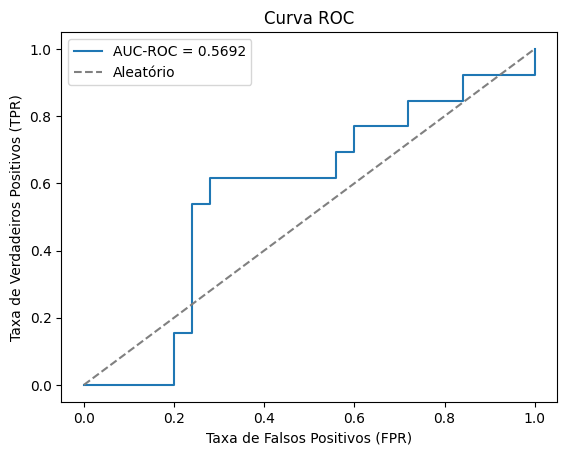

In [35]:
# Calcula a AUC-ROC média para todas as classes
from sklearn.metrics import roc_curve, roc_auc_score

# Verifica se y_test é um array NumPy, caso contrário, converta
y_test = np.array(y_test)

# Obter as probabilidades preditas pelo modelo
y_pred_probs = model.predict(X_test)

# Calcula a AUC-ROC
auc_roc = roc_auc_score(y_test, y_pred_probs)  # Probabilidades da classe positiva (mulheres)
print(f"AUC-ROC: {auc_roc:.2f}")

# Calcula a Curva ROC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_probs)  # Probabilidades da classe positiva

# Plotando a curva ROC
plt.figure()
plt.plot(fpr, tpr, label=f'AUC-ROC = {auc_roc:.4f}')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Aleatório')
plt.xlabel('Taxa de Falsos Positivos (FPR)')
plt.ylabel('Taxa de Verdadeiros Positivos (TPR)')
plt.title('Curva ROC')
plt.legend()
plt.show()

